# processing eae 5k

## load packages

In [1]:
import warnings
warnings.filterwarnings('ignore')
import os
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans

## data retrival

In [3]:
ad = sc.read_h5ad('/Volumes/processing2/output_spinal_cord_injury/spinal_cord_injury_merged_outer.h5ad')


In [4]:
sc.pp.calculate_qc_metrics(ad, percent_top=None, log1p=False, inplace=True)
    

In [5]:
ad.obs.batch.unique()

['Data_AJ__Slide1__m50_s4', 'Data_AJ__Slide3__m_50_s_4', 'Slide11__region0__m_50_s_4', 'Slide11__region1__m_50_s_4', 'Slide11__region2__m_50_s_4', ..., 'slide21-DD__region_liver-d4-2__m50_s4', 'slide21-DD__region_myelin-d14-1__m50_s4', 'slide21-DD__region_myelin-d14-2__m50_s4', 'slide21-DD__region_myelin-d14-3__m50_s4', 'slide21-DD__region_myelin-d14-4__m50_s4']
Length: 66
Categories (66, object): ['Data_AJ__Slide1__m50_s4', 'Data_AJ__Slide3__m_50_s_4', 'Slide11__region0__m_50_s_4', 'Slide11__region1__m_50_s_4', ..., 'slide21-DD__region_myelin-d14-1__m50_s4', 'slide21-DD__region_myelin-d14-2__m50_s4', 'slide21-DD__region_myelin-d14-3__m50_s4', 'slide21-DD__region_myelin-d14-4__m50_s4']

In [6]:
ad.obs['sample_id'] = ad.obs.batch

In [7]:
ad.obs = ad.obs.reset_index()

,n_cells,mean_counts,mean_genes
sample_id,,,
Data_AJ__Slide1__m50_s4,416904,80.176412,39.222353
slide20__region_7d-1__m50_s4,335063,80.164587,41.234156
Slide12__region2__m_50_s_4,270935,59.004182,31.373687
slide20__region_5d-1__baysor_m50_scale4,263684,76.052419,39.210134
Slide2__region1__m_50_s_4,257416,46.758224,27.986003
...,...,...,...
Slide11__region0__m_50_s_4,1646,23.995747,17.698663
Slide19-DD-1d-2d-myelin-liver__region_1d-myelin-3__baysor_m50_scale4,1551,24.269504,19.441651
slide18-DD-5d-7d-myelin-liver__region_liver-5d-unc__baysor_m50_scale4,1498,26.357143,19.564753


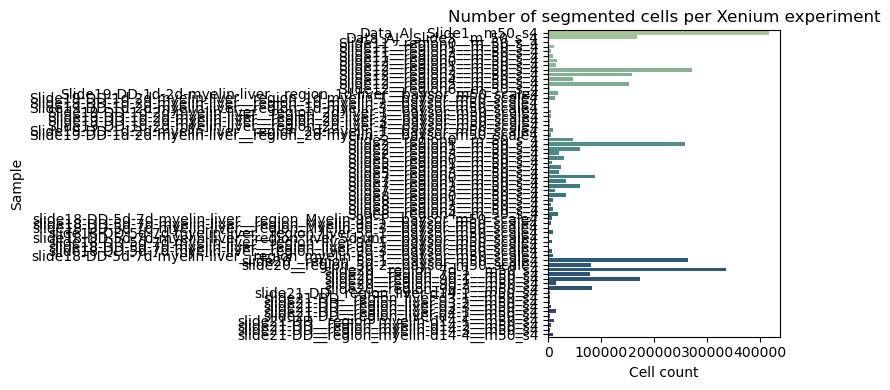

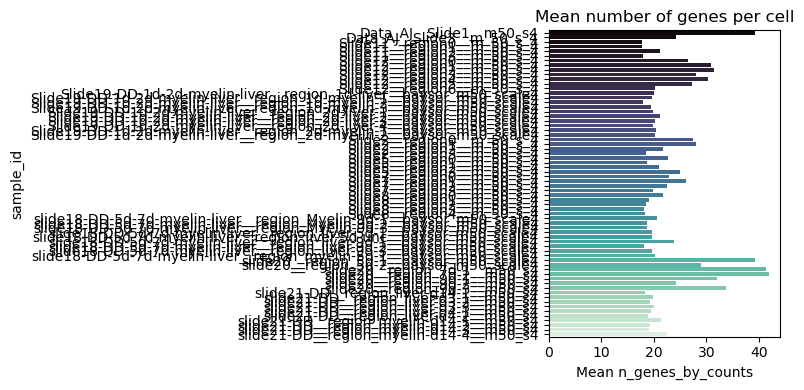

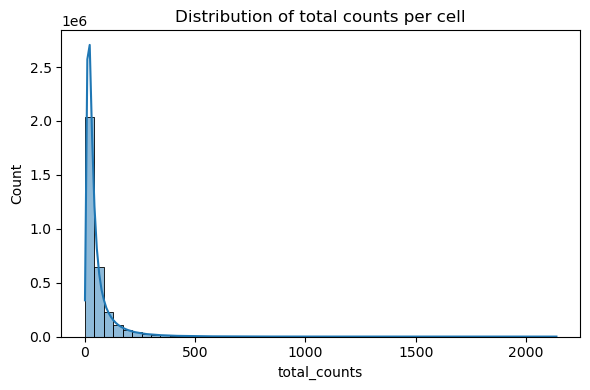

In [8]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# --- Load your Xenium dataset ---
# --- Example: basic summary table ---
summary = (
    ad.obs.groupby("sample_id")
    .agg(
        n_cells=("cell", "count"),
        mean_counts=("total_counts", "mean"),
        mean_genes=("n_genes_by_counts", "mean"),
    )
    .sort_values("n_cells", ascending=False)
)
display(summary)

# --- Plot 1: Cell count per sample ---
plt.figure(figsize=(8,4))
sns.barplot(y=summary.index, x=summary["n_cells"], palette="crest")
plt.title("Number of segmented cells per Xenium experiment")
plt.xlabel("Cell count")
plt.ylabel("Sample")
plt.tight_layout()
plt.show()

# --- Plot 2: Mean detected genes per sample ---
plt.figure(figsize=(8,4))
sns.barplot(y=summary.index, x=summary["mean_genes"], palette="mako")
plt.title("Mean number of genes per cell")
plt.xlabel("Mean n_genes_by_counts")
plt.tight_layout()
plt.show()

# --- Plot 3: Distributions of total counts ---
plt.figure(figsize=(6,4))
sns.histplot(ad.obs["total_counts"], bins=50, kde=True)
plt.title("Distribution of total counts per cell")
plt.xlabel("total_counts")
plt.tight_layout()
plt.show()

# --- Plot 4: Composition of cell types ---
if "cell_types" in ad.obs:
    ct_counts = ad.obs["cell_types"].value_counts()
    plt.figure(figsize=(8,4))
    sns.barplot(y=ct_counts.index[:15], x=ct_counts.values[:15], palette="viridis")
    plt.title("Top 15 cell types (by abundance)")
    plt.xlabel("Number of cells")
    plt.tight_layout()
    plt.show()

# --- Plot 5: Cell type composition per sample ---
if {"cell_types","sample_id"}.issubset(ad.obs.columns):
    comp = (
        ad.obs.groupby(["sample_id","cell_types"])
        .size()
        .groupby(level=0)
        .apply(lambda x: x / x.sum())
        .unstack(fill_value=0)
    )
    plt.figure(figsize=(10,5))
    comp.plot(kind="bar", stacked=True, colormap="tab20", figsize=(10,5))
    plt.ylabel("Fraction of cells")
    plt.title("Cell type composition per Xenium experiment")
    plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

,n_cells,counts_mean,counts_median,counts_p10,counts_p90,genes_mean,genes_median,genes_p10,genes_p90
sample_id,,,,,,,,,
Data_AJ__Slide1__m50_s4,416904,80.176412,44.0,10.0,186.0,39.222353,32.0,9.0,81.0
slide20__region_7d-1__m50_s4,335063,80.164587,46.0,12.0,191.0,41.234156,34.0,11.0,83.0
Slide12__region2__m_50_s_4,270935,59.004182,35.0,11.0,130.0,31.373687,25.0,9.0,62.0
slide20__region_5d-1__baysor_m50_scale4,263684,76.052419,41.0,12.0,180.0,39.210134,31.0,11.0,81.0
Slide2__region1__m_50_s_4,257416,46.758224,31.0,11.0,94.0,27.986003,23.0,10.0,52.0
...,...,...,...,...,...,...,...,...,...
Slide11__region0__m_50_s_4,1646,23.995747,21.0,11.0,41.0,17.698663,17.0,9.0,27.0
Slide19-DD-1d-2d-myelin-liver__region_1d-myelin-3__baysor_m50_scale4,1551,24.269504,22.0,11.0,39.0,19.441651,18.0,10.0,30.0
slide18-DD-5d-7d-myelin-liver__region_liver-5d-unc__baysor_m50_scale4,1498,26.357143,20.0,9.0,50.0,19.564753,17.0,9.0,35.0


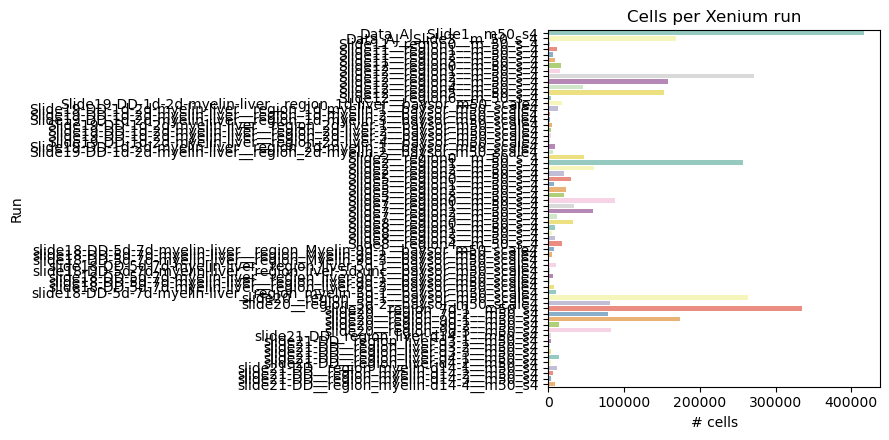

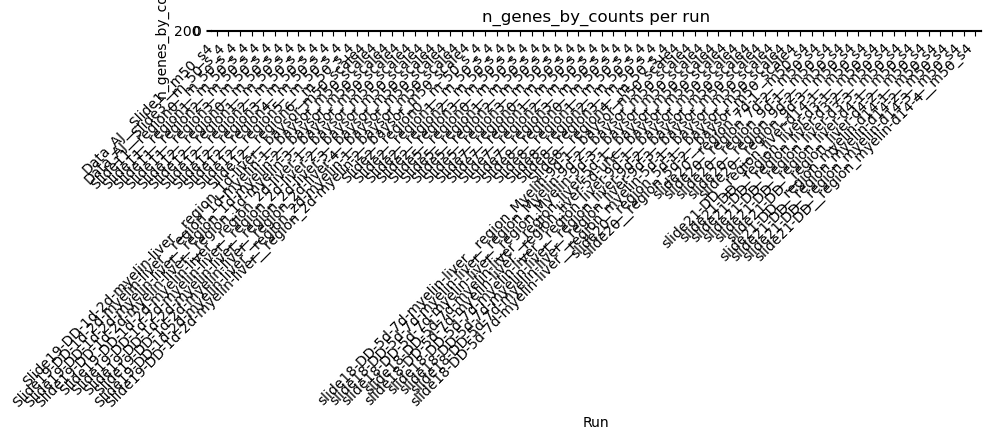

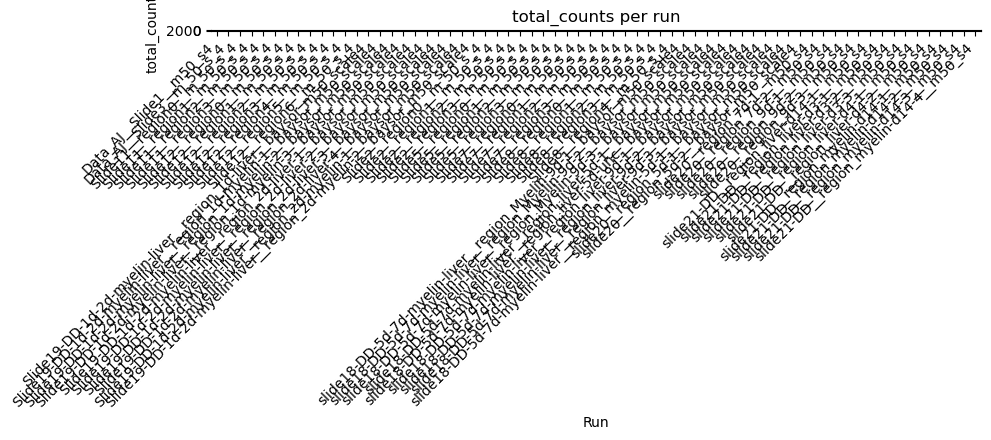

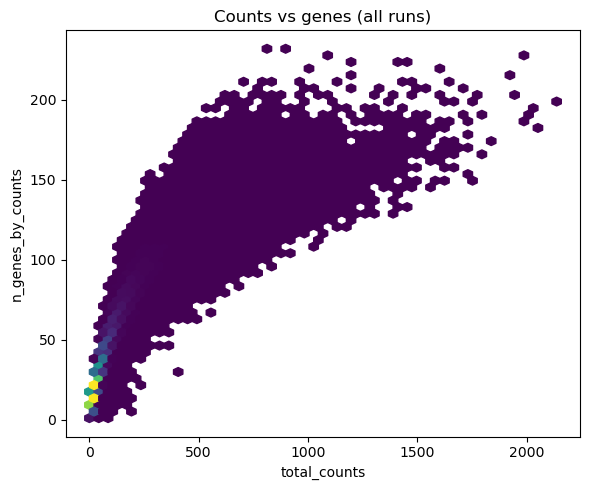

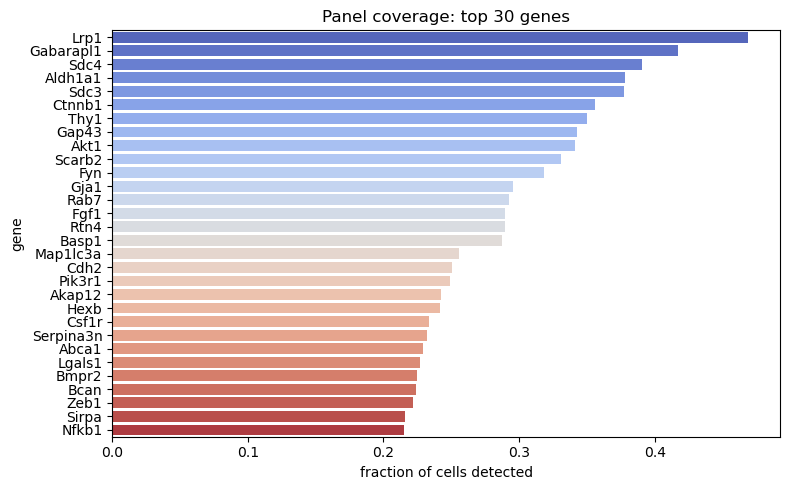

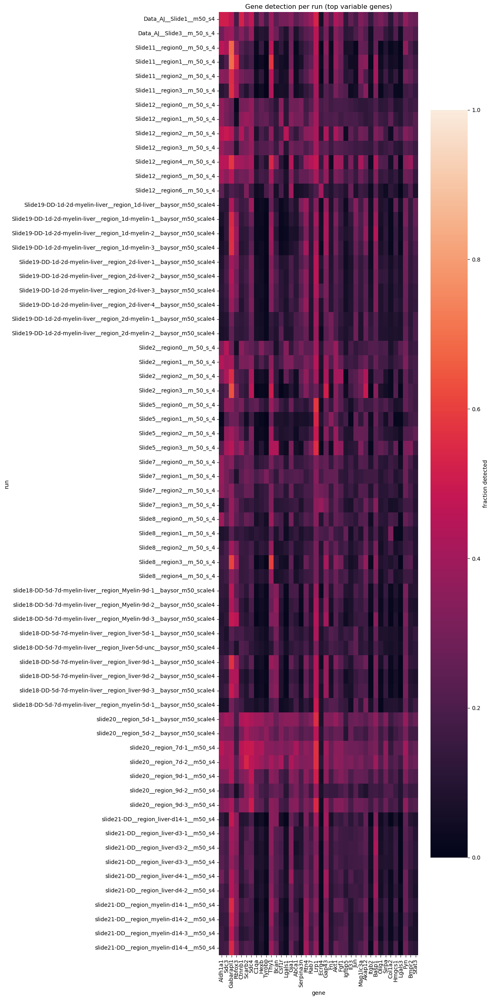

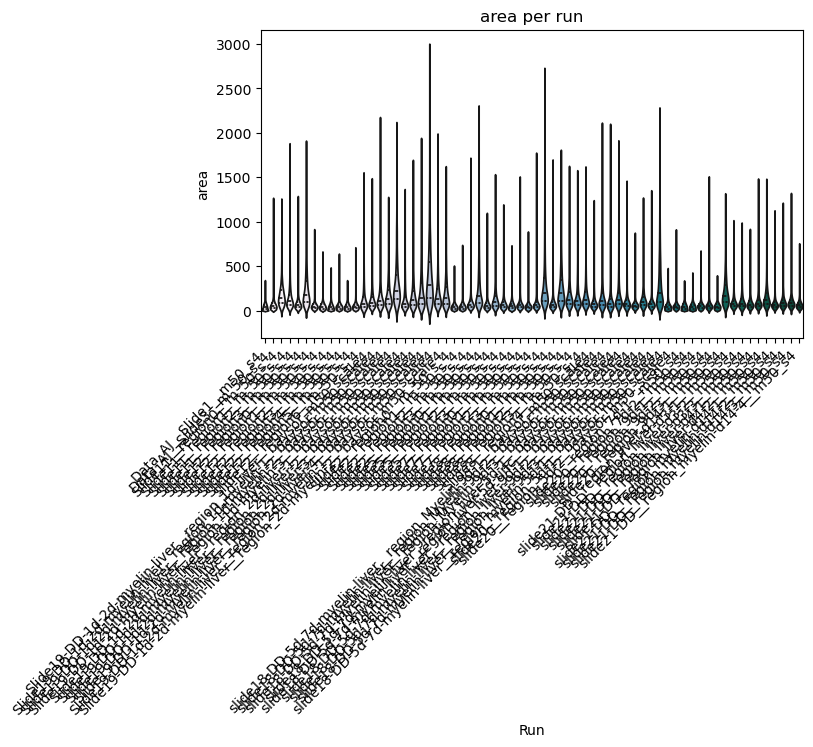

✓ saved outputs to xenium_qc/


In [9]:
# --- Xenium QC dashboard (drop-in) ---
import os, numpy as np, pandas as pd, scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

# ====== config (rename if your column names differ) ======
RUN_COL     = "batch"            # batch/slide/run id
SAMPLE_COL  = "sample_id"      # sample or library id
CT_COL      = "cell_types"     # cell-type column (optional)
COUNTS_COL  = "total_counts"   # transcripts per cell
NGENES_COL  = "n_genes_by_counts"
SAVE_DIR    = "xenium_qc"
os.makedirs(SAVE_DIR, exist_ok=True)

# ====== 1) summary table (per run) ======
cols = [c for c in [RUN_COL, SAMPLE_COL, CT_COL, COUNTS_COL, NGENES_COL] if c in ad.obs.columns]
assert RUN_COL in ad.obs, f"Missing column '{RUN_COL}' in ad.obs"

def _p(x,p): return np.nanpercentile(x, p)

agg_dict = {"cell_id":("cell_id","count")} if "cell_id" in ad.obs else {"index":("index","count")}
if COUNTS_COL in ad.obs:
    agg_dict |= {
        "counts_mean":(COUNTS_COL,"mean"),
        "counts_median":(COUNTS_COL,"median"),
        "counts_p10":(COUNTS_COL,lambda x:_p(x,10)),
        "counts_p90":(COUNTS_COL,lambda x:_p(x,90)),
    }
if NGENES_COL in ad.obs:
    agg_dict |= {
        "genes_mean":(NGENES_COL,"mean"),
        "genes_median":(NGENES_COL,"median"),
        "genes_p10":(NGENES_COL,lambda x:_p(x,10)),
        "genes_p90":(NGENES_COL,lambda x:_p(x,90)),
    }

summary = (
    ad.obs.reset_index()
      .groupby(SAMPLE_COL)
      .agg(**agg_dict)
      .rename(columns={"cell_id":"n_cells","index":"n_cells"})
      .sort_values("n_cells", ascending=False)
)
display(summary)
#summary.to_csv(f"{SAVE_DIR}/summary_by_run.csv")

# ====== 2) plots: cell counts & QC per run ======
plt.figure(figsize=(9,4.5))
sns.barplot(y=summary.index, x=summary["n_cells"], palette="Set3")
plt.title("Cells per Xenium run")
plt.xlabel("# cells"); plt.ylabel("Run")
plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/cells_per_run_bar.png", dpi=200); plt.show()

if NGENES_COL in ad.obs:
    plt.figure(figsize=(10,4.5))
    sns.violinplot(data=ad.obs, x=SAMPLE_COL, y=NGENES_COL, inner="quartile", palette="rocket")
    plt.title("n_genes_by_counts per run"); plt.xlabel("Run"); plt.ylabel("n_genes_by_counts")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/ngenes_violin.png", dpi=200); plt.show()

if COUNTS_COL in ad.obs:
    plt.figure(figsize=(10,4.5))
    sns.violinplot(data=ad.obs, x=SAMPLE_COL, y=COUNTS_COL, inner="quartile", palette="mako")
    plt.title("total_counts per run"); plt.xlabel("Run"); plt.ylabel("total_counts")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/counts_violin.png", dpi=200); plt.show()

# counts vs genes hex
if set([COUNTS_COL, NGENES_COL]).issubset(ad.obs.columns):
    plt.figure(figsize=(6,5))
    plt.hexbin(ad.obs[COUNTS_COL], ad.obs[NGENES_COL], gridsize=50, mincnt=1)
    plt.xlabel("total_counts"); plt.ylabel("n_genes_by_counts")
    plt.title("Counts vs genes (all runs)")
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/counts_vs_genes_hex.png", dpi=200); plt.show()

# ====== 3) cell-type composition ======
if CT_COL in ad.obs:
    ct_counts = ad.obs[CT_COL].value_counts()
    plt.figure(figsize=(9,5))
    sns.barplot(y=ct_counts.index[:20], x=ct_counts.values[:20], palette="Spectral")
    plt.title("Top cell types (all runs)"); plt.xlabel("# cells"); plt.ylabel("cell type")
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/celltypes_top20.png", dpi=200); plt.show()

    # per run stacked fractions (collapse tail to 'Other' for readability)
    topK = 14
    ct_top = ct_counts.index[:topK].tolist()
    comp = (
        ad.obs.assign(ct_plot=lambda d: d[CT_COL].where(d[CT_COL].isin(ct_top), other="Other"))
              .groupby([SAMPLE_COL, "ct_plot"]).size()
              .groupby(level=0).apply(lambda x: x/x.sum())
              .unstack(fill_value=0)
    )
    ax = comp.plot(kind="bar", stacked=True, figsize=(10,5), colormap="tab20")
    plt.ylabel("fraction of cells"); plt.title("Cell-type composition per run")
    plt.legend(bbox_to_anchor=(1.02,1), loc="upper left", ncol=1)
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/celltypes_per_run_stacked.png", dpi=200); plt.show()

# ====== 4) panel coverage (gene detection rate) ======
# fraction of cells with X>0 per gene (overall & per run)
try:
    import scipy.sparse as sp
    X = ad.X
    is_sparse = sp.issparse(X)
    # overall detection
    if is_sparse:
        detected = (X > 0).astype(np.int8)
        det_overall = np.array(detected.sum(axis=0)).ravel() / ad.n_obs
    else:
        det_overall = (X > 0).sum(axis=0) / ad.n_obs
    det_overall = pd.Series(det_overall, index=ad.var_names, name="fraction_cells")
    det_overall.sort_values(ascending=False).to_csv(f"{SAVE_DIR}/gene_detection_overall.csv")
    # top 30 genes by detection
    top30 = det_overall.sort_values(ascending=False).head(30)
    plt.figure(figsize=(8,5))
    sns.barplot(y=top30.index, x=top30.values, palette="coolwarm")
    plt.xlabel("fraction of cells detected"); plt.ylabel("gene"); plt.title("Panel coverage: top 30 genes")
    plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/gene_detection_top30.png", dpi=200); plt.show()

    # per-run detection heatmap (top N informative genes)
    if SAMPLE_COL in ad.obs:
        # compute per run
        runs = ad.obs[SAMPLE_COL].astype(str).values
        run_idx = {r: np.where(runs == r)[0] for r in np.unique(runs)}
        det_run = {}
        for r, idx in run_idx.items():
            if len(idx)==0: continue
            if is_sparse:
                sub = X[idx,:]
                frac = np.array((sub > 0).sum(axis=0)).ravel() / len(idx)
            else:
                sub = X[idx,:]
                frac = (sub > 0).sum(axis=0) / len(idx)
            det_run[r] = frac
        det_df = pd.DataFrame(det_run, index=ad.var_names).T  # runs × genes

        # pick top genes by overall variance
        var_rank = det_df.var(axis=0).sort_values(ascending=False)
        sel = var_rank.head(40).index
        plt.figure(figsize=(min(12, len(sel)*0.3+4), max(4, len(det_df)*0.35+2)))
        sns.heatmap(det_df[sel], cmap="rocket", vmin=0, vmax=1, cbar_kws={"label":"fraction detected"})
        plt.title("Gene detection per run (top variable genes)")
        plt.xlabel("gene"); plt.ylabel("run")
        plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/gene_detection_heatmap_runs.png", dpi=200); plt.show()
except Exception as e:
    print(f"[panel coverage] skipped: {e}")

# ====== 5) nice-to-haves (only if columns exist) ======
# Size/area QC (Xenium often provides cell area)
for cand in ["cell_area_um2","cell_area","area","nucleus_area_um2"]:
    if cand in ad.obs:
        plt.figure(figsize=(7,4))
        sns.violinplot(data=ad.obs, x=SAMPLE_COL, y=cand, inner="quartile", palette="PuBuGn")
        plt.title(f"{cand} per run"); plt.xlabel("Run"); plt.xticks(rotation=45, ha="right")
        plt.tight_layout(); plt.savefig(f"{SAVE_DIR}/{cand}_violin.png", dpi=200); plt.show()
        break

print(f"✓ saved outputs to {SAVE_DIR}/")

## preprocessing

### calculate qc metrics and filter cells for counts and number of genes

In [10]:
sc.pp.calculate_qc_metrics(ad, percent_top=None, log1p=False, inplace=True)
sc.pp.filter_cells(ad,min_counts=20)

In [11]:
ad

AnnData object with n_obs × n_vars = 2304049 × 500
    obs: 'cell', 'x', 'y', 'z', 'cluster', 'n_transcripts', 'density', 'elongation', 'area', 'avg_confidence', 'avg_assignment_confidence', 'max_cluster_frac', 'lifespan', 'sample', 'source_dir', 'batch', 'n_genes_by_counts', 'total_counts', 'sample_id', 'n_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

### normalizing and transforming

In [12]:
sc.pp.normalize_total(ad, inplace=True,target_sum=100)
sc.pp.log1p(ad)
#sc.pp.scale(ad, )#max_value=10)

### pca and neighbors

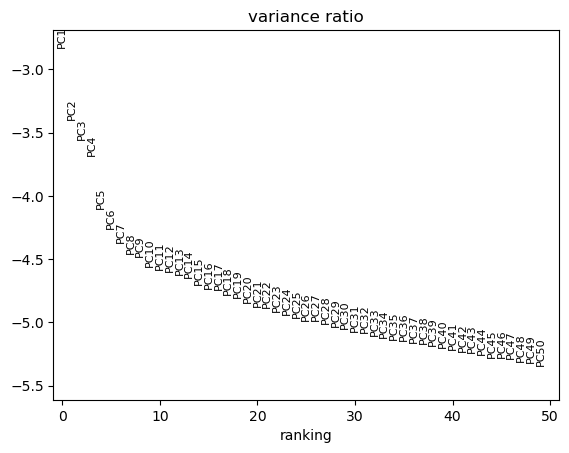

In [13]:
plt.rcdefaults()
sc.tl.pca(ad)
sc.pl.pca_variance_ratio(ad, n_pcs=50, log=True)
sc.pp.neighbors(ad, n_neighbors=15, n_pcs=30)

### umap

In [14]:
sc.tl.umap(ad, min_dist=0.1)

### clustering

Clustering at resolution 0.5...
Done.


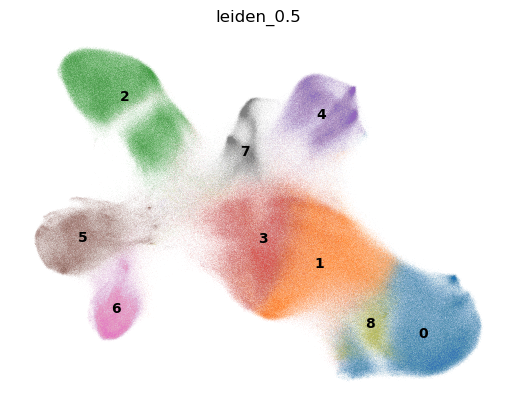

Clustering at resolution 1...
Done.


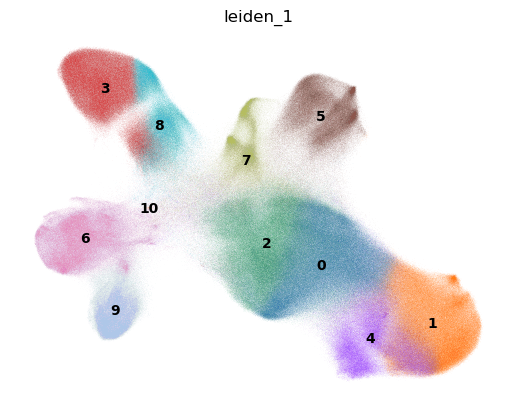

Clustering at resolution 1.5...


KeyboardInterrupt: 

In [15]:
resolutions = [0.5, 1,1.5, 2]

for resolution in resolutions:
    key = f'leiden_{resolution}'

    if key in ad.obs.columns:
        print(f"Skipping {resolution}: {key} already exists.")
    else:
        print(f"Clustering at resolution {resolution}...")
        sc.tl.leiden(ad, resolution=resolution, key_added=key)
        print("Done.")

    # plot UMAP
    sc.pl.umap(ad, color=key, legend_loc='on data', frameon=False)

In [17]:
ad.obs

,cell,x,y,z,cluster,n_transcripts,density,elongation,area,avg_confidence,...,lifespan,sample,source_dir,batch,n_genes_by_counts,total_counts,sample_id,n_counts,leiden_0.5,leiden_1
0,CRf57c8efed-1-Data_AJ__Slide1__m50_s4,5246.016087,-24.153639,0.985507,2,69,1.9130,1.455,36.060,0.9967,...,50,Data_AJ__Slide#1,/Volumes/processing2/spinal_cord_injury/data/D...,Data_AJ__Slide1__m50_s4,40,69.0,Data_AJ__Slide1__m50_s4,69.0,2,8
1,CRf57c8efed-10-Data_AJ__Slide1__m50_s4,5236.265158,-6.743055,4.221790,3,257,2.3880,1.349,107.600,0.9965,...,50,Data_AJ__Slide#1,/Volumes/processing2/spinal_cord_injury/data/D...,Data_AJ__Slide1__m50_s4,117,257.0,Data_AJ__Slide1__m50_s4,257.0,5,6
2,CRf57c8efed-100-Data_AJ__Slide1__m50_s4,5225.981178,66.628877,3.181034,3,116,1.3230,1.950,87.700,0.9942,...,50,Data_AJ__Slide#1,/Volumes/processing2/spinal_cord_injury/data/D...,Data_AJ__Slide1__m50_s4,60,116.0,Data_AJ__Slide1__m50_s4,116.0,6,9
3,CRf57c8efed-1000-Data_AJ__Slide1__m50_s4,5585.402272,20.694899,2.924658,2,146,1.5600,1.249,93.570,0.9951,...,50,Data_AJ__Slide#1,/Volumes/processing2/spinal_cord_injury/data/D...,Data_AJ__Slide1__m50_s4,68,146.0,Data_AJ__Slide1__m50_s4,146.0,2,8
4,CRf57c8efed-10000-Data_AJ__Slide1__m50_s4,3376.101780,2778.602835,5.550000,3,20,2.9340,6.252,6.817,0.9958,...,50,Data_AJ__Slide#1,/Volumes/processing2/spinal_cord_injury/data/D...,Data_AJ__Slide1__m50_s4,20,20.0,Data_AJ__Slide1__m50_s4,20.0,5,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3205794,CR8f11c6c65-994-slide21-DD__region_myelin-d14-...,3088.399668,7191.274470,3.000000,2,47,0.5855,1.502,80.270,0.9906,...,50,slide21-DD__region_myelin-d14-4,/Users/christoffer/Downloads/new_spinal_cord_d...,slide21-DD__region_myelin-d14-4__m50_s4,29,47.0,slide21-DD__region_myelin-d14-4__m50_s4,47.0,0,1
3205795,CR8f11c6c65-995-slide21-DD__region_myelin-d14-...,2732.002228,7558.982836,2.886792,2,53,0.2106,1.084,251.700,0.8872,...,50,slide21-DD__region_myelin-d14-4,/Users/christoffer/Downloads/new_spinal_cord_d...,slide21-DD__region_myelin-d14-4__m50_s4,32,53.0,slide21-DD__region_myelin-d14-4__m50_s4,53.0,3,2
3205796,CR8f11c6c65-996-slide21-DD__region_myelin-d14-...,3185.412542,7096.957204,1.875000,2,48,0.2670,1.783,179.800,0.9684,...,50,slide21-DD__region_myelin-d14-4,/Users/christoffer/Downloads/new_spinal_cord_d...,slide21-DD__region_myelin-d14-4__m50_s4,34,48.0,slide21-DD__region_myelin-d14-4__m50_s4,48.0,0,1
3205797,CR8f11c6c65-997-slide21-DD__region_myelin-d14-...,2642.995415,7646.391341,2.302326,2,86,0.7811,1.231,110.100,0.9901,...,50,slide21-DD__region_myelin-d14-4,/Users/christoffer/Downloads/new_spinal_cord_d...,slide21-DD__region_myelin-d14-4__m50_s4,43,86.0,slide21-DD__region_myelin-d14-4__m50_s4,86.0,0,1


### write clustered data

In [18]:
ad.write('/Volumes/processing2/output_spinal_cord_injury/processed/spinal_cord_injury.h5ad')

In [29]:
ad = sc.read('../data/mtDNA_DSB_5k_clustered.h5ad')

### add spatial information

In [19]:
spatial = np.array(ad.obs[['x','y']])
ad.obsm['spatial'] = spatial

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
from matplotlib.lines import Line2D
from matplotlib.gridspec import GridSpec

def plot_spatial_compact(
    ad,
    color="leiden_2",
    groupby="sample_id",
    spot_size=18,
    cols=3,
    height=8,                    # figure height (inches)
    legend_col_width=1.2,        # width (inches) reserved for legend
):
    sids = list(ad.obs[groupby].unique())
    n = len(sids)
    rows = int(np.ceil(n / cols))

    # compute figure width: panels + skinny legend column
    panel_w = height * cols * 0.6 / rows   # keeps a pleasing aspect
    fig_w = panel_w + legend_col_width
    fig = plt.figure(figsize=(fig_w, height), constrained_layout=False)

    # Grid: left (panels), right (legend)
    gs = GridSpec(
        rows, cols + 1, figure=fig,
        width_ratios=[1]*cols + [legend_col_width / (fig_w - legend_col_width)],
        wspace=0.02, hspace=0.02
    )

    # colors/categories (respect ad.uns if present)
    cats = ad.obs[color].astype("category").cat.categories
    if f"{color}_colors" in ad.uns:
        cols_list = ad.uns[f"{color}_colors"]
    else:
        base = sc.plotting.palettes.default_20
        cols_list = (base * int(np.ceil(len(cats)/len(base))))[:len(cats)]

    # panels
    for i, sid in enumerate(sids):
        r, c = divmod(i, cols)
        ax = fig.add_subplot(gs[r, c])
        ad_sub = ad[ad.obs[groupby] == sid].copy()

        sc.pl.spatial(
            ad_sub,
            color=color,
            spot_size=spot_size,
            show=False,
            ax=ax,
            legend_loc=None,
            frameon=False,     # no frame
            title=sid,         # short title; comment out to save more space
        )
        # remove axis labels Scanpy adds ("spatial1/2")
        ax.set_xlabel(""); ax.set_ylabel("")
        ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

    # blank unused axes (if any)
    for j in range(n, rows*cols):
        r, c = divmod(j, cols)
        fig.add_subplot(gs[r, c]).axis("off")

    # legend in the skinny column
    ax_leg = fig.add_subplot(gs[:, -1])
    ax_leg.axis("off")
    handles = [
        Line2D([0],[0], marker='o', color='w',
               markerfacecolor=cols_list[k], markersize=7, label=str(cat))
        for k, cat in enumerate(cats)
    ]
    ax_leg.legend(handles=handles, title=color, frameon=False, loc="center left")

    # squeeze outer margins
    fig.subplots_adjust(left=0.01, right=0.98, top=0.98, bottom=0.02, wspace=0.02, hspace=0.02)
    plt.show()



In [21]:
ad

AnnData object with n_obs × n_vars = 2304049 × 500
    obs: 'cell', 'x', 'y', 'z', 'cluster', 'n_transcripts', 'density', 'elongation', 'area', 'avg_confidence', 'avg_assignment_confidence', 'max_cluster_frac', 'lifespan', 'sample', 'source_dir', 'batch', 'n_genes_by_counts', 'total_counts', 'sample_id', 'n_counts', 'leiden_0.5', 'leiden_1'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden_0.5', 'leiden_0.5_colors', 'leiden_1', 'leiden_1_colors'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [24]:
"""
Fast, compact spatial plotting function for AnnData objects.

This function creates multi-panel spatial plots grouped by a specified column (e.g., sample_id),
with support for both categorical and continuous color schemes, highlighting, and custom layouts.
"""

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.lines import Line2D
from matplotlib import colors as mcolors
import scanpy as sc
from pandas.api.types import is_numeric_dtype, is_categorical_dtype
from scipy.sparse import issparse


def plot_spatial_compact_fast(
    ad,
    color="leiden_2",       # obs column *or* gene name
    groupby="sample_id",
    spot_size=8,
    cols=3,
    height=8,
    legend_col_width=1.2,
    palette=None,
    rasterized=True,
    invert_y=True,
    dpi=120,
    highlight=None,
    group_order=None,
    background="white",
    grey_alpha=0.2,         # alpha for non-highlighted categories
    vmin=None,
    vmax=None,
    cmap_name="viridis",
    shared_scale=False,     # if True: vmin/vmax from whole `ad` (not per subset)
):
    """
    Plot spatial data in a compact multi-panel layout.

    Parameters
    ----------
    ad : AnnData
        Annotated data object with spatial coordinates in ad.obsm['spatial']
    color : str
        Column in ad.obs or gene name in ad.var_names to color by
    groupby : str
        Column in ad.obs to group panels by (e.g., 'sample_id')
    spot_size : float
        Size of scatter points
    cols : int
        Number of columns in the grid layout
    height : float
        Figure height in inches
    legend_col_width : float
        Width allocated for legend/colorbar column
    palette : dict, list, or str, optional
        Color palette for categorical data or colormap name for continuous
    rasterized : bool
        Whether to rasterize scatter plots (recommended for large datasets)
    invert_y : bool
        Whether to invert y-axis (common for imaging coordinates)
    dpi : int
        Figure DPI
    highlight : str, list, optional
        For categorical data: which categories to highlight (others are greyed)
    group_order : list, optional
        Custom order for groups (panels)
    background : str
        Background color ('white' or 'black')
    grey_alpha : float
        Alpha value for non-highlighted categories (0-1)
    vmin : float, optional
        Minimum value for continuous color scale
    vmax : float, optional
        Maximum value for continuous color scale
    cmap_name : str
        Colormap name for continuous data
    shared_scale : bool
        If True, use same vmin/vmax across all panels for continuous data

    Returns
    -------
    None
        Displays the plot
    """
    # pick background + text color
    fig_face = background
    ax_face = background
    text_color = "white" if background in ("black", "#000000", "k") else "black"

    # ----- 0) Preconditions -----
    if "spatial" not in ad.obsm:
        raise ValueError("ad.obsm['spatial'] not found")

    if groupby not in ad.obs.columns:
        raise KeyError(f"groupby {groupby!r} not in ad.obs")

    # decide where 'color' comes from: obs vs var (gene)
    if color in ad.obs.columns:
        color_source = "obs"
        col_series = ad.obs[color]
    elif color in ad.var_names:
        color_source = "var"   # gene expression
        col_series = None
    else:
        raise KeyError(
            f"{color!r} not found in ad.obs.columns or ad.var_names "
            "(expected an obs column or a gene name)."
        )

    coords = np.asarray(ad.obsm["spatial"])[:, :2]

    # Detect continuous vs categorical
    if color_source == "var":
        # genes: always continuous
        is_continuous = True
    else:
        if is_categorical_dtype(col_series):
            is_continuous = False
        else:
            is_continuous = is_numeric_dtype(col_series)

    # ----------------------------------------------------
    # 1) Build colors_arr differently for cont vs cat
    # ----------------------------------------------------
    if is_continuous:
        # ===== CONTINUOUS MODE =====
        if color_source == "obs":
            vals = col_series.to_numpy(dtype=float)
        else:
            # from var / gene expression
            gene_idx = ad.var_names.get_loc(color)
            x = ad.X[:, gene_idx]
            if issparse(x):
                vals = x.toarray().ravel()
            else:
                vals = np.asarray(x).ravel()

        # choose colormap
        if palette is None:
            cmap = plt.get_cmap(cmap_name)
        elif isinstance(palette, str):
            cmap = plt.get_cmap(palette)
        else:
            cmap = palette

        # ----- determine vmin/vmax -----
        if shared_scale:
            # global min/max across the *full AnnData* passed to this function
            full = ad
            if color_source == "var":
                gx = full.X[:, full.var_names.get_loc(color)]
                if issparse(gx):
                    full_vals = gx.toarray().ravel()
                else:
                    full_vals = np.asarray(gx).ravel()
            else:
                full_vals = pd.to_numeric(full.obs[color], errors="coerce").to_numpy()

            finite_full = np.isfinite(full_vals)
            if finite_full.sum() == 0:
                raise ValueError(f"All values for '{color}' are NaN or non-finite.")
            vmin_use = float(np.min(full_vals[finite_full]))
            vmax_use = float(np.max(full_vals[finite_full]))
        else:
            finite_mask = np.isfinite(vals)
            if finite_mask.sum() == 0:
                raise ValueError(f"All values for '{color}' are NaN or non-finite.")
            vmin_use = float(np.min(vals[finite_mask]))
            vmax_use = float(np.max(vals[finite_mask]))

        # user overrides everything
        if vmin is not None:
            vmin_use = float(vmin)
        if vmax is not None:
            vmax_use = float(vmax)

        # avoid zero-range
        if vmin_use == vmax_use:
            vmin_use -= 1.0
            vmax_use += 1.0

        norm = mcolors.Normalize(vmin=vmin_use, vmax=vmax_use)

        colors_arr = np.zeros((vals.size, 4), dtype=float)
        finite_mask = np.isfinite(vals)
        colors_arr[finite_mask] = cmap(norm(vals[finite_mask]))
        colors_arr[~finite_mask] = (0, 0, 0, 0)

        # store continuous settings in uns (also fine for genes)
        ad.uns[f"{color}_continuous"] = {
            "vmin": float(vmin_use),
            "vmax": float(vmax_use),
            "cmap": cmap.name if hasattr(cmap, "name") else str(cmap),
        }

        cat_names = None
        cat_codes = None

    else:
        # ===== CATEGORICAL (only for obs) =====
        # preserve existing categorical order if present
        if is_categorical_dtype(col_series):
            cats = col_series.cat.remove_unused_categories()
        else:
            cats = col_series.astype("category")

        cat_names = cats.cat.categories
        cat_codes = cats.cat.codes.to_numpy()

        # palette handling
        if isinstance(palette, dict):
            col_list = [palette[c] for c in cat_names]
        elif isinstance(palette, (list, tuple)):
            if len(palette) < len(cat_names):
                raise ValueError("Palette shorter than number of categories.")
            col_list = list(palette)[:len(cat_names)]
        elif f"{color}_colors" in ad.uns:
            col_list = list(ad.uns[f"{color}_colors"])
            if len(col_list) != len(cat_names):
                raise ValueError(f"{color}_colors length != categories.")
        else:
            base = list(
                sc.pl.palettes.default_64
                if hasattr(sc.pl.palettes, "default_64")
                else sc.pl.palettes.default_102
            )
            reps = int(np.ceil(len(cat_names) / len(base)))
            col_list = (base * reps)[:len(cat_names)]

        ad.uns[f"{color}_colors"] = col_list

        rgba = np.array([mcolors.to_rgba(c) for c in col_list], dtype=float)

        colors_arr = np.empty((cat_codes.size, 4), dtype=float)
        colors_arr[cat_codes >= 0] = rgba[cat_codes[cat_codes >= 0]]
        colors_arr[cat_codes < 0] = (0, 0, 0, 0)

        # ----- highlighting logic -----
        if highlight is not None:
            # allow single value or list/tuple/array
            if not isinstance(highlight, (list, tuple, set, np.ndarray)):
                highlight = [highlight]
            # convert to string for robust matching
            highlight_str = {str(h) for h in highlight}

            cat_name_str = np.array([str(c) for c in cat_names])
            keep_cat_mask = np.isin(cat_name_str, list(highlight_str))  # per-category

            # use user-defined alpha for greyed-out categories
            grey_rgba = (0.8, 0.8, 0.8, float(grey_alpha))

            valid = cat_codes >= 0
            keep_flag = np.zeros_like(cat_codes, dtype=bool)
            keep_flag[valid] = keep_cat_mask[cat_codes[valid]]

            # grey out all non-highlighted cells
            colors_arr[valid & ~keep_flag] = grey_rgba

            # also grey in legend
            col_list = [
                col_list[k] if keep_cat_mask[k] else mcolors.to_hex(grey_rgba)
                for k in range(len(cat_names))
            ]

    # ----------------------------------------------------
    # 2) Precompute group indices (RESPECT ORDERED CATEGORICAL)
    # ----------------------------------------------------
    gser = ad.obs[groupby]

    if group_order is not None:
        group_order = [str(g) for g in group_order]
        present = set(gser.astype(str))
        uniq_groups = [g for g in group_order if g in present]
    else:
        # if groupby is an ordered categorical, respect its category order
        if is_categorical_dtype(gser) and gser.cat.ordered:
            cats = list(gser.cat.categories)
            present = set(gser.astype(str))
            uniq_groups = [str(c) for c in cats if str(c) in present]
        else:
            # fallback: sorted unique strings
            uniq_groups = sorted(gser.astype(str).unique())

    gvals = gser.astype(str).to_numpy()
    gid_to_idx = {g: i for i, g in enumerate(uniq_groups)}
    gcodes = np.array([gid_to_idx.get(g, -1) for g in gvals], dtype=int)

    group_indices = [np.flatnonzero(gcodes == gi) for gi in range(len(uniq_groups))]

    # ----------------------------------------------------
    # 3) Figure layout
    # ----------------------------------------------------
    n = len(uniq_groups)
    rows = int(np.ceil(n / cols))
    panel_w = height * cols * 0.6 / rows
    fig_w = panel_w + legend_col_width

    plt.ioff()
    fig = plt.figure(figsize=(fig_w, height), dpi=dpi, constrained_layout=False)

    # background for figure
    fig.patch.set_facecolor(fig_face)

    gs = GridSpec(
        rows, cols + 1, figure=fig,
        width_ratios=[1]*cols + [legend_col_width / (fig_w - legend_col_width)],
        wspace=0.02, hspace=0.02
    )

    # ----------------------------------------------------
    # 4) Panels
    # ----------------------------------------------------
    for i, sid in enumerate(uniq_groups):
        r, c = divmod(i, cols)
        ax = fig.add_subplot(gs[r, c])

        # panel background
        ax.set_facecolor(ax_face)

        idx = group_indices[i]
        if idx.size:
            xy = coords[idx]
            ax.scatter(
                xy[:, 0], -xy[:, 1],
                c=colors_arr[idx],
                s=spot_size,
                marker='o',
                linewidths=0,
                rasterized=rasterized
            )

        meta_strings = []

        if "region" in ad.obs.columns:
            region_vals = (
                ad.obs.loc[ad.obs[groupby] == sid, "region"]
                .dropna().astype(str).unique()
            )
            if len(region_vals) == 0:
                meta_strings.append("Region: unknown")
            elif len(region_vals) == 1:
                meta_strings.append(f"Region: {region_vals[0]}")
            else:
                meta_strings.append("Region: mixed")

        if "course" in ad.obs.columns:
            course_vals = (
                ad.obs.loc[ad.obs[groupby] == sid, "course"]
                .dropna().astype(str).unique()
            )
            if len(course_vals) == 0:
                meta_strings.append("Course: unknown")
            elif len(course_vals) == 1:
                meta_strings.append(f"Course: {course_vals[0]}")
            else:
                meta_strings.append("Course: mixed")

        if meta_strings:
            title = f"{sid}\n[{ ' | '.join(meta_strings) }]"
        else:
            title = str(sid)

        ax.set_title(title, fontsize=5, pad=2, color=text_color)
        ax.set_aspect("equal")
        if invert_y:
            ax.invert_yaxis()
        ax.set_axis_off()

    # blank unused panels
    for j in range(n, rows * cols):
        r, c = divmod(j, cols)
        ax = fig.add_subplot(gs[r, c])
        ax.set_facecolor(ax_face)
        ax.axis("off")

    # ----------------------------------------------------
    # 5) Legend / Colorbar
    # ----------------------------------------------------
    ax_leg = fig.add_subplot(gs[:, -1])
    ax_leg.set_facecolor(ax_face)
    ax_leg.axis("off")

    if is_continuous:
        sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])
        cbar = fig.colorbar(sm, cax=ax_leg)
        cbar.set_label(color, rotation=90, color=text_color)
        cbar.ax.yaxis.set_tick_params(color=text_color)
        plt.setp(plt.getp(cbar.ax.axes, "yticklabels"), color=text_color)
    else:
        handles = [
            Line2D(
                [0], [0], marker="o", color="w",
                markerfacecolor=col_list[k], markersize=7, label=str(cat)
            )
            for k, cat in enumerate(cat_names)
        ]
        leg = ax_leg.legend(
            handles=handles,
            title=color,
            frameon=False,
            loc="center left",
            labelcolor=text_color,
            title_fontsize=10
        )
        leg.get_title().set_color(text_color)
        for text in leg.get_texts():
            text.set_color(text_color)

    fig.subplots_adjust(
        left=0.01, right=0.98, top=0.98, bottom=0.02,
        wspace=0.02, hspace=0.02
    )

    plt.ion()
    plt.show()


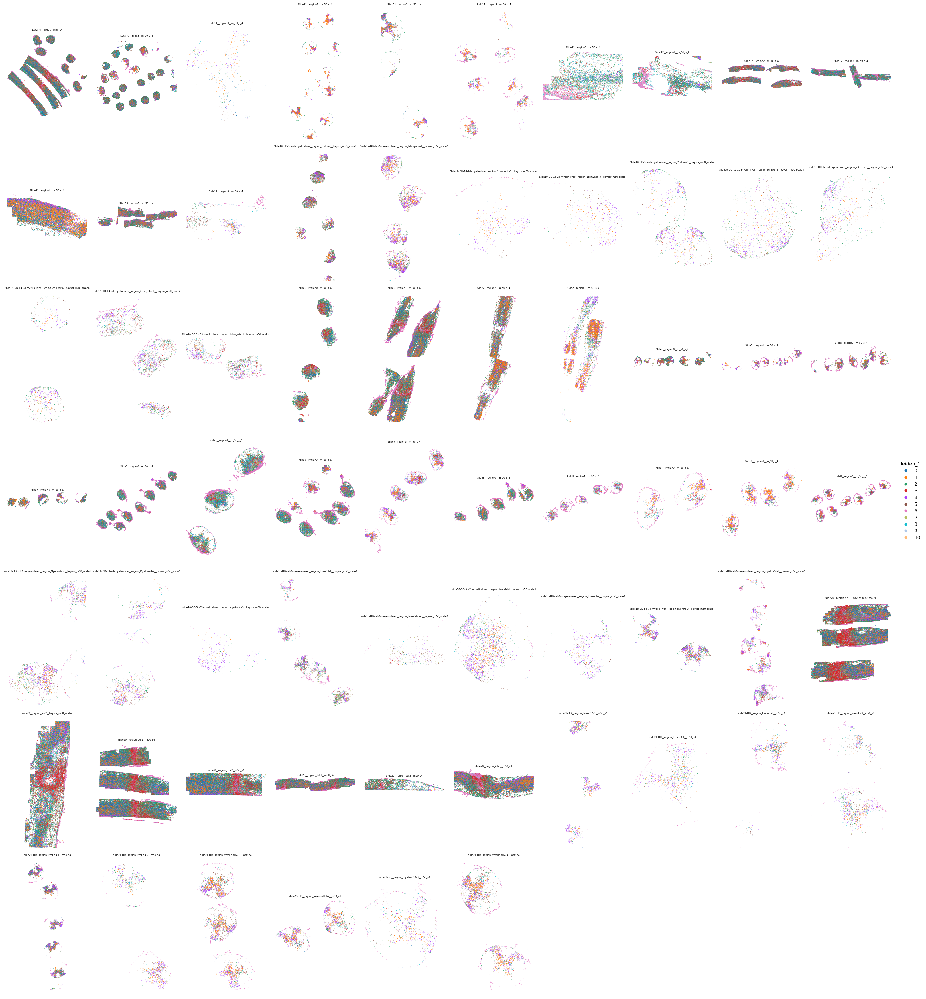

In [25]:
# Visualize MANA clustering (resolution 0.5 as starting point)
plot_spatial_compact_fast(
    ad,
    color='leiden_1',
    groupby='sample_id',  # Adjust to your actual sample column
    spot_size = 0.5,
    cols=10,
    height=30,
    background='white',
    dpi=120
)

### plot clusters on basis of coordinates

Data_AJ__Slide1__m50_s4


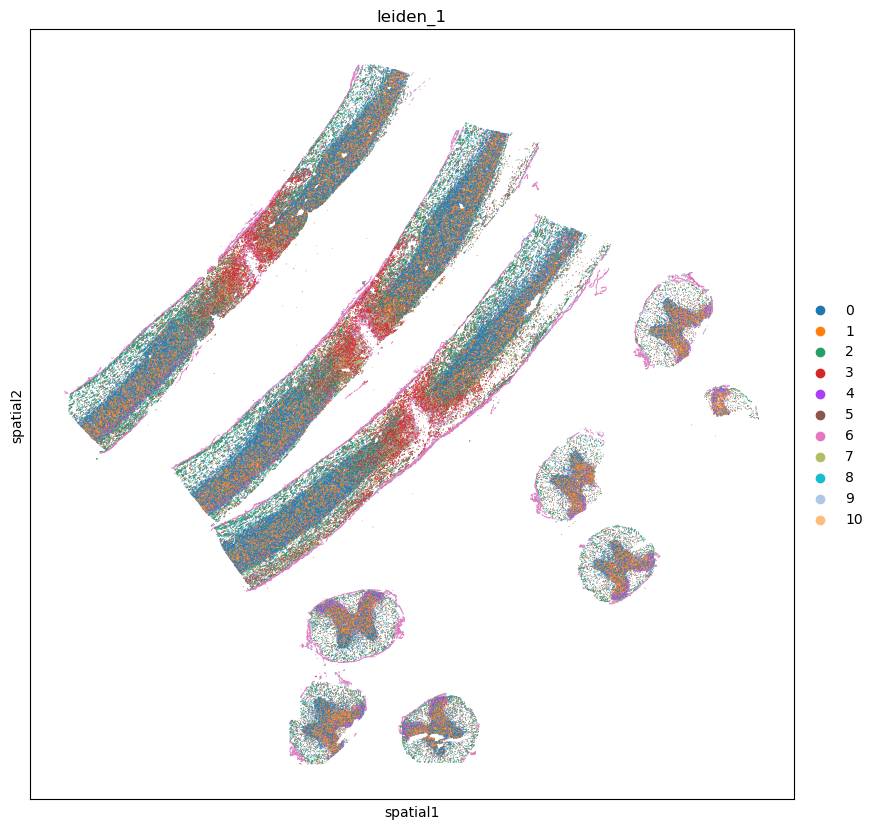

Data_AJ__Slide3__m_50_s_4


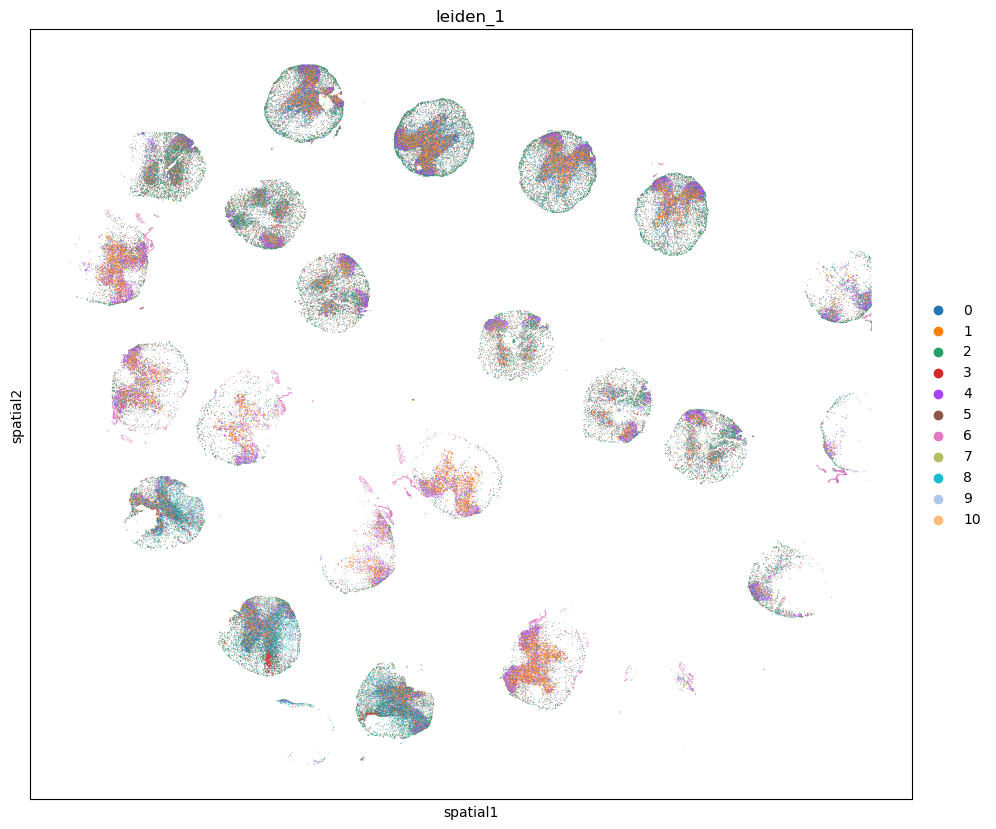

Slide11__region0__m_50_s_4


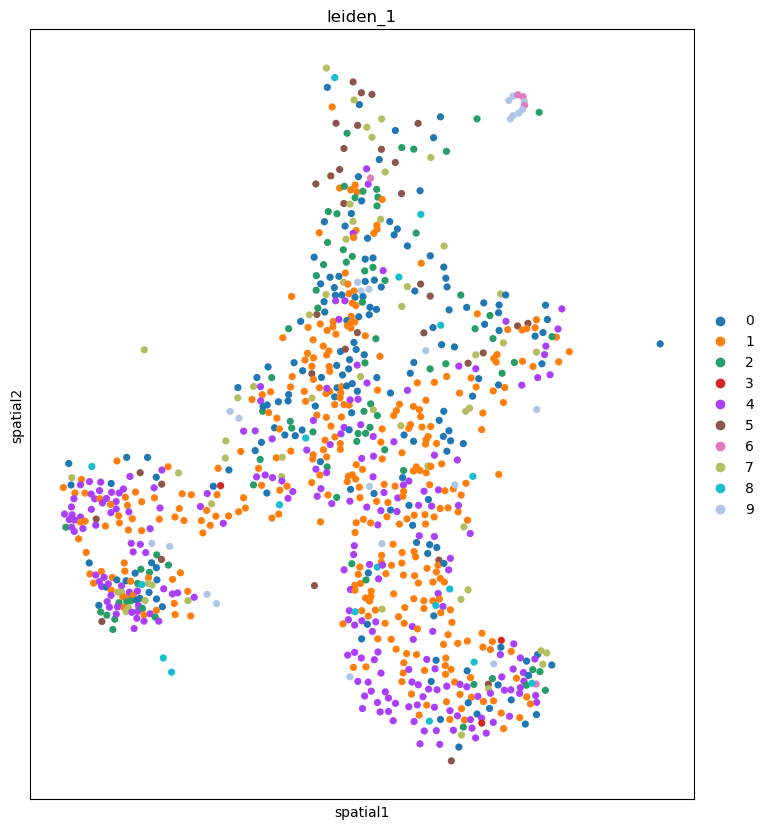

Slide11__region1__m_50_s_4


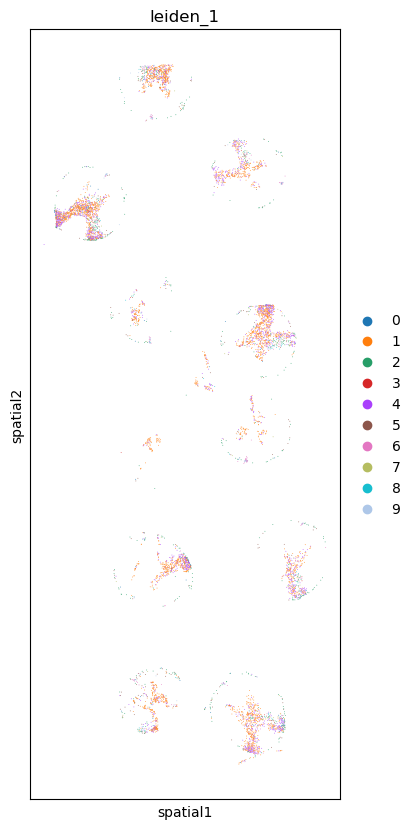

Slide11__region2__m_50_s_4


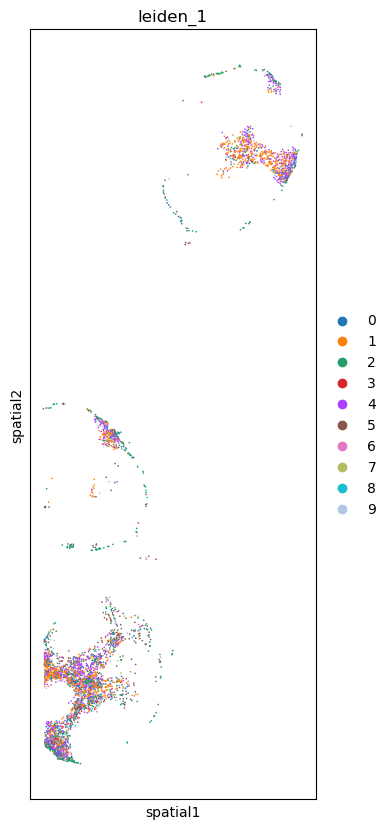

Slide11__region3__m_50_s_4


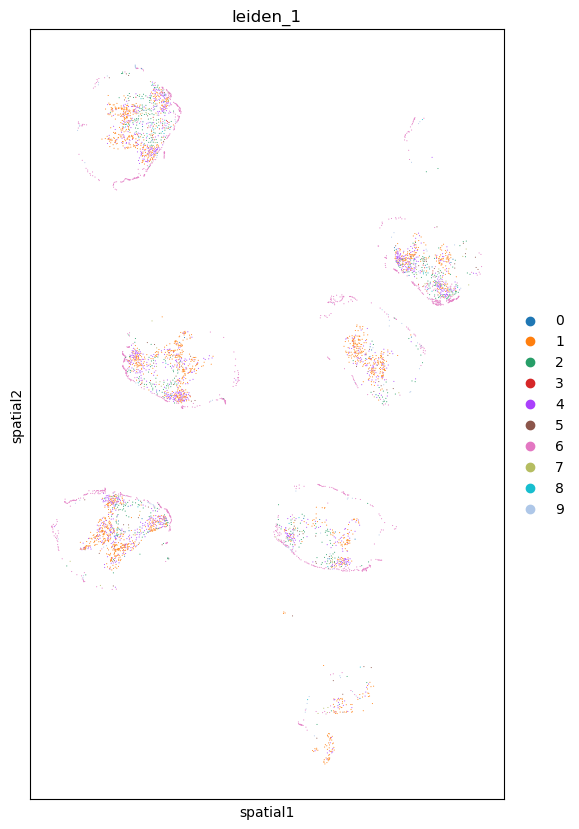

Slide12__region0__m_50_s_4


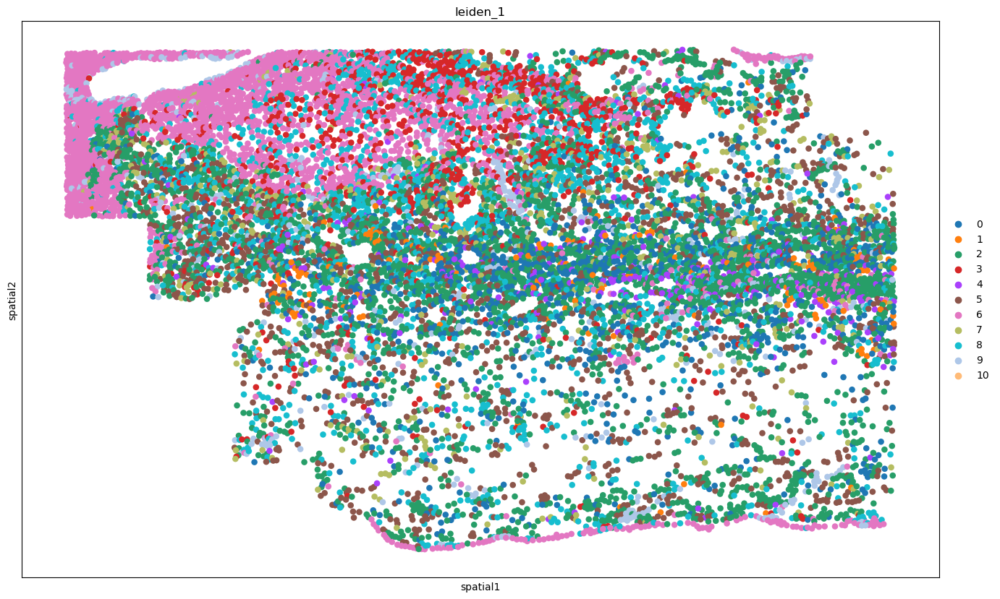

Slide12__region1__m_50_s_4


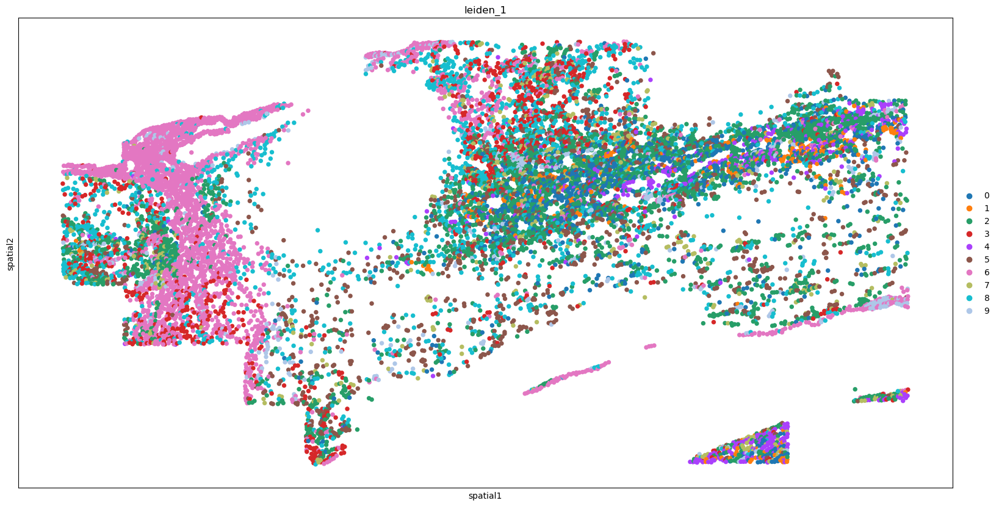

Slide12__region2__m_50_s_4


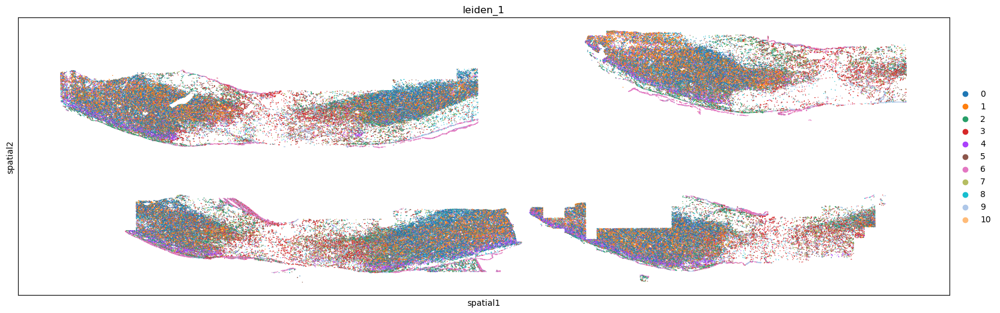

Slide12__region3__m_50_s_4


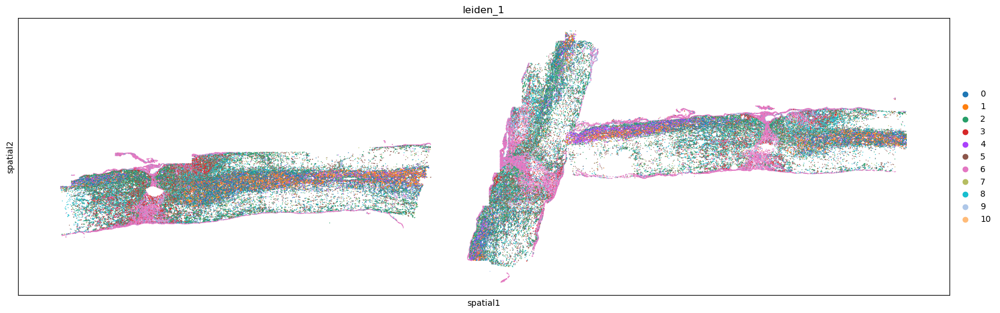

Slide12__region4__m_50_s_4


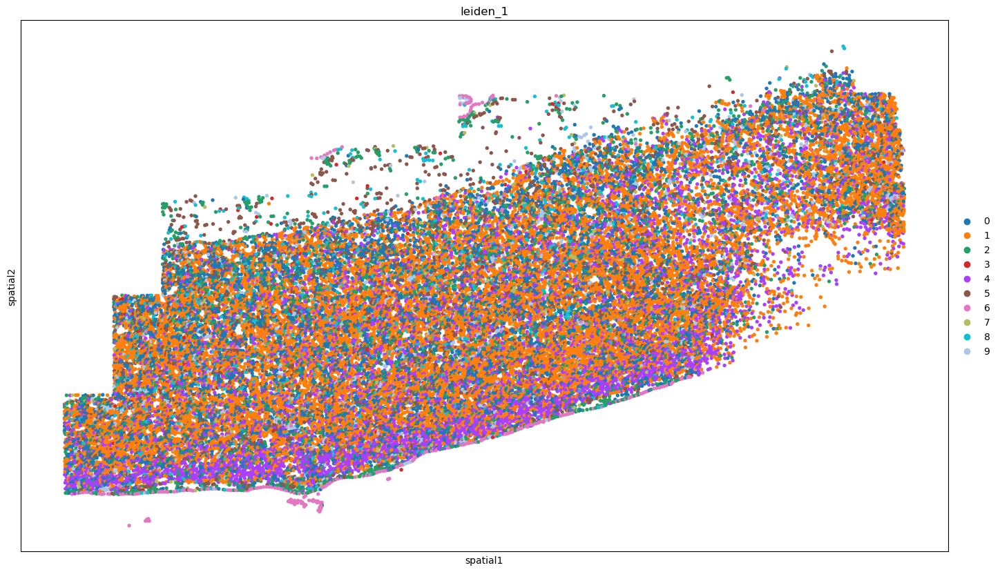

Slide12__region5__m_50_s_4


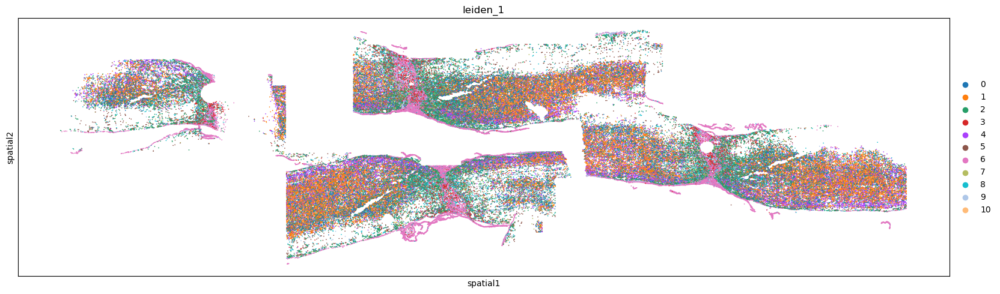

Slide12__region6__m_50_s_4


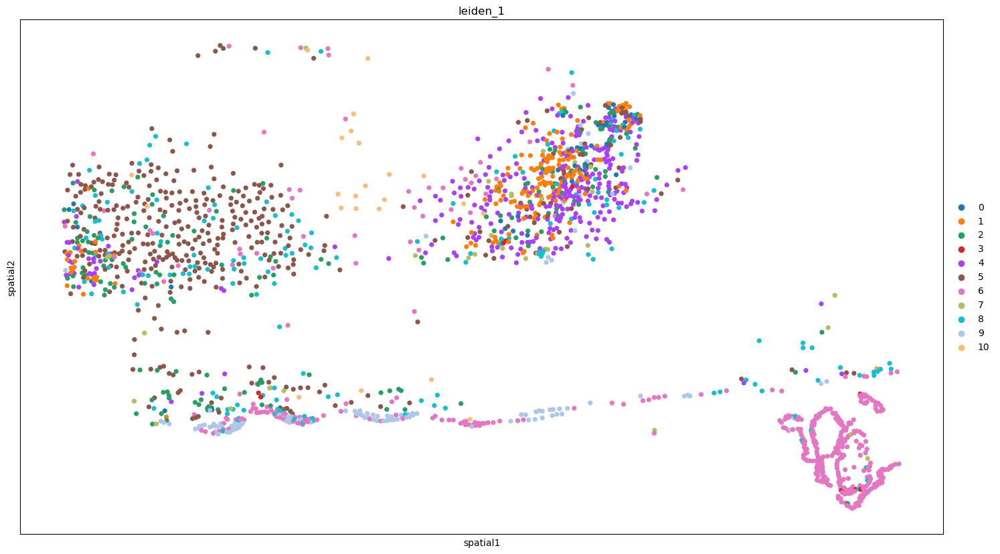

Slide19-DD-1d-2d-myelin-liver__region_1d-liver__baysor_m50_scale4


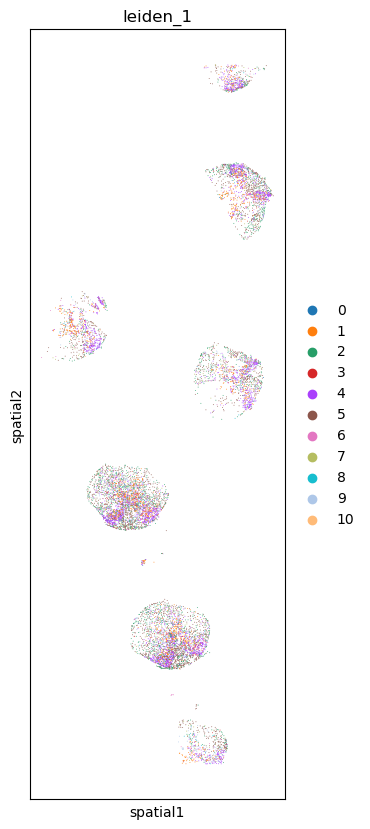

Slide19-DD-1d-2d-myelin-liver__region_1d-myelin-1__baysor_m50_scale4


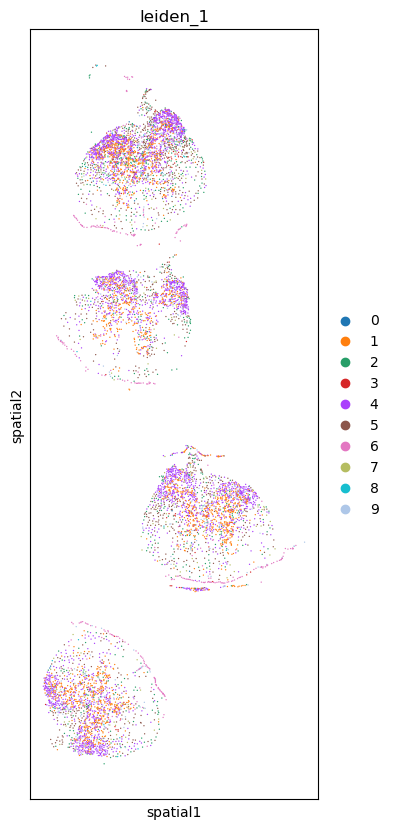

Slide19-DD-1d-2d-myelin-liver__region_1d-myelin-2__baysor_m50_scale4


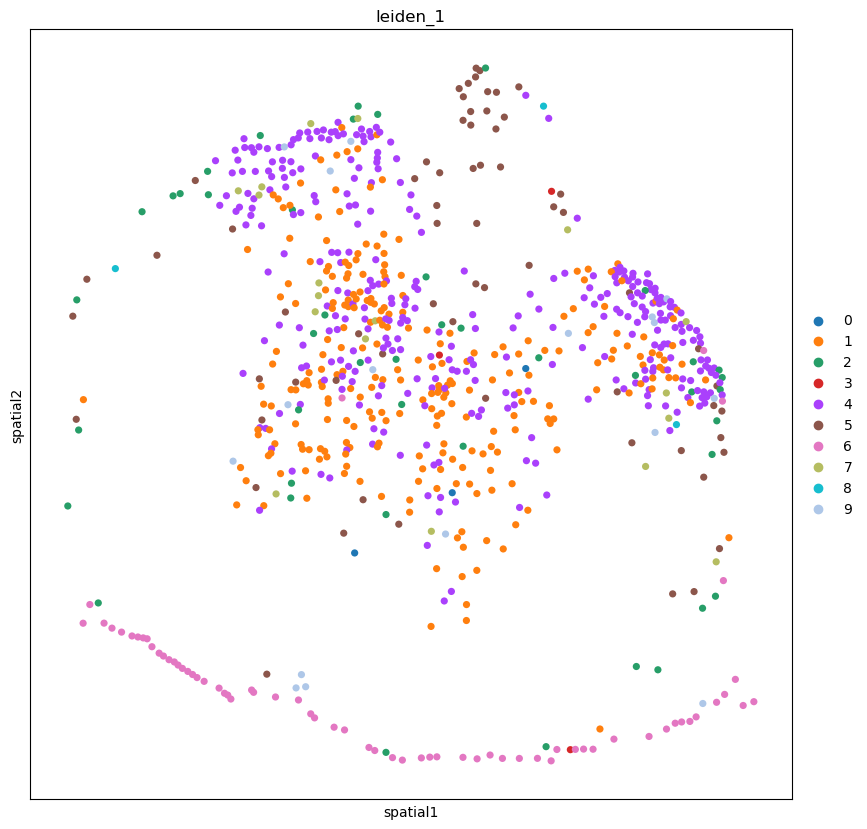

Slide19-DD-1d-2d-myelin-liver__region_1d-myelin-3__baysor_m50_scale4


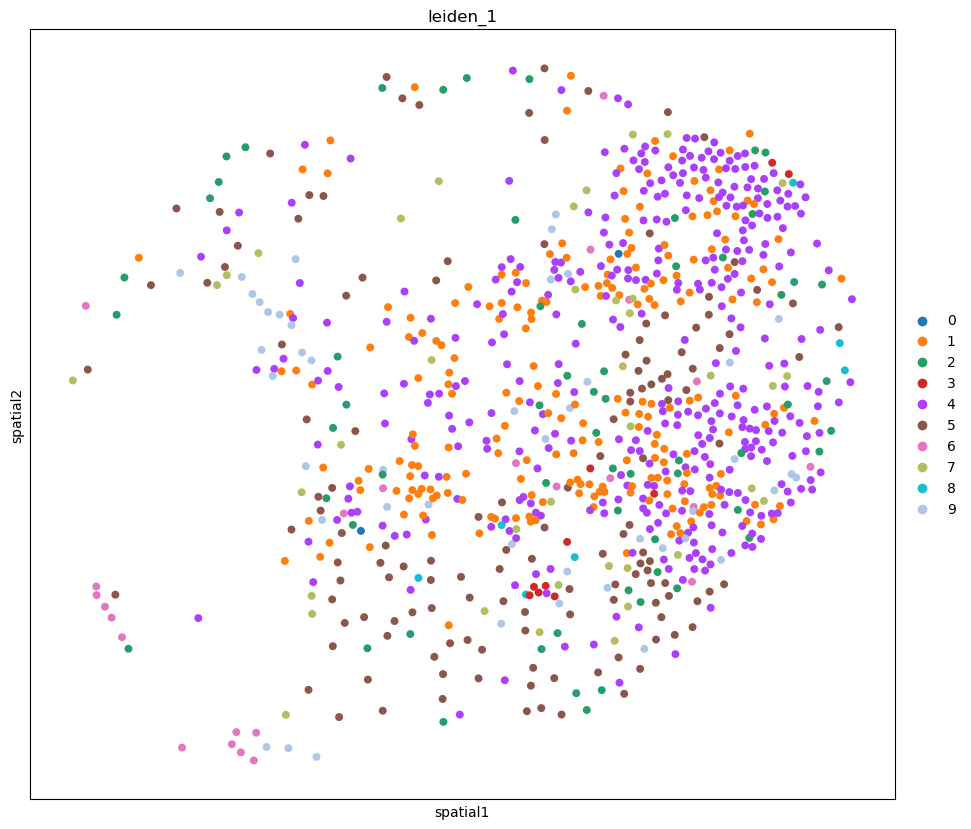

Slide19-DD-1d-2d-myelin-liver__region_2d-liver-1__baysor_m50_scale4


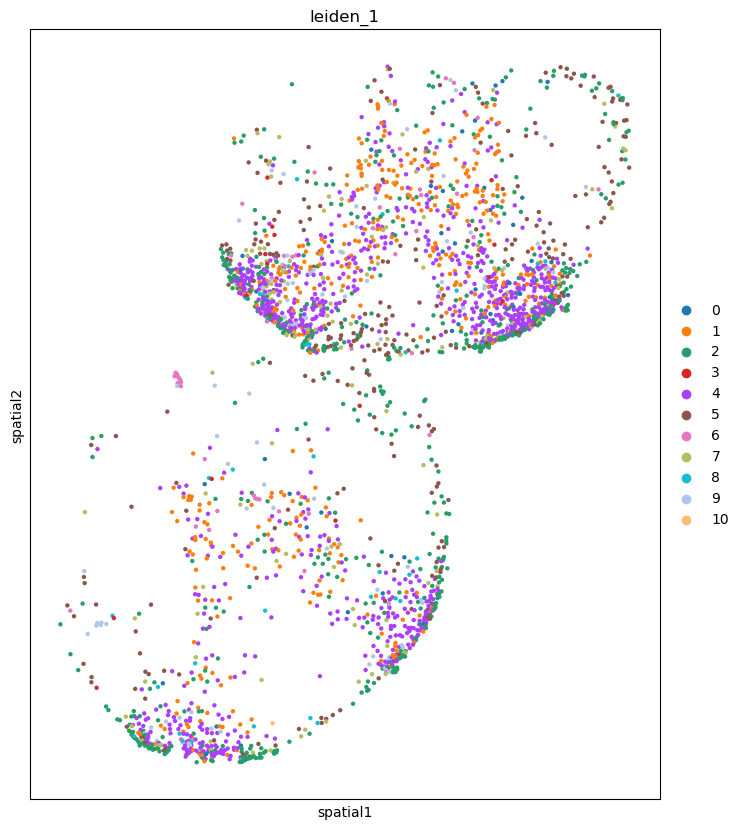

Slide19-DD-1d-2d-myelin-liver__region_2d-liver-2__baysor_m50_scale4


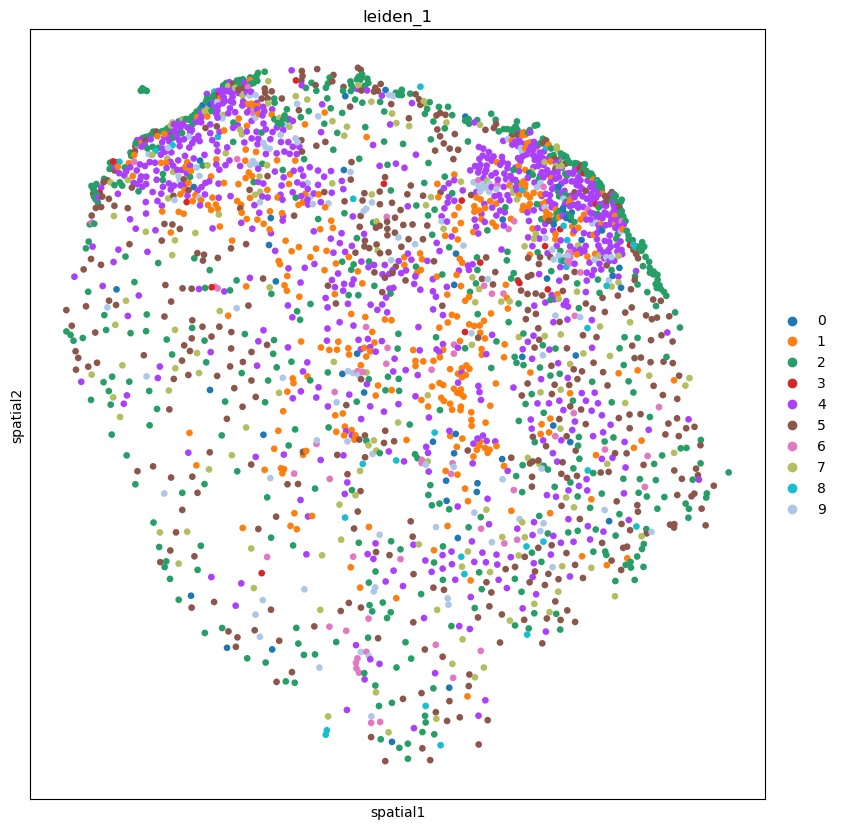

Slide19-DD-1d-2d-myelin-liver__region_2d-liver-3__baysor_m50_scale4


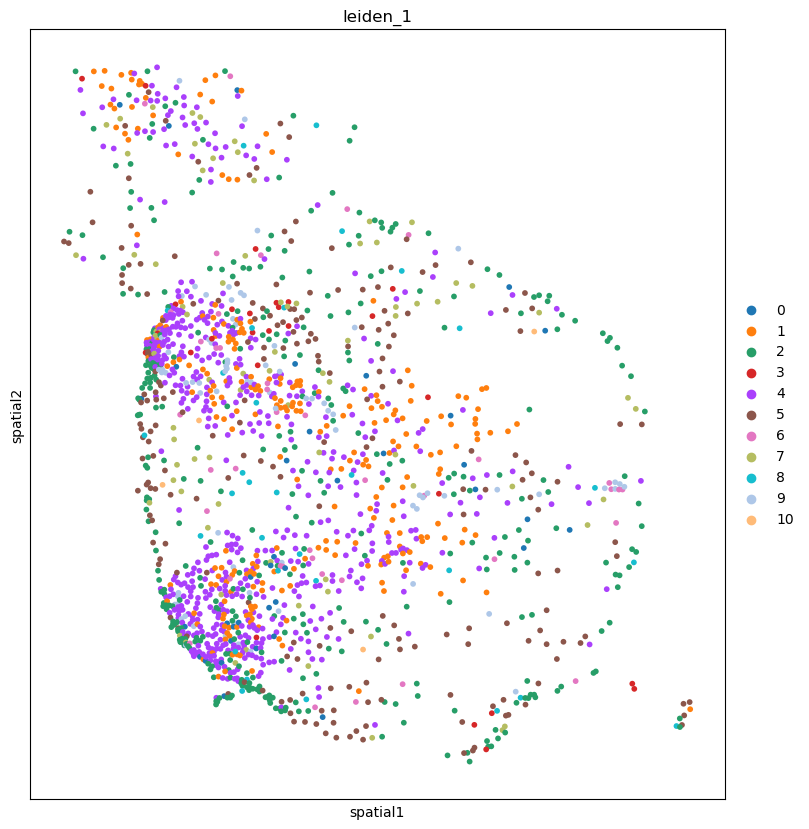

Slide19-DD-1d-2d-myelin-liver__region_2d-liver-4__baysor_m50_scale4


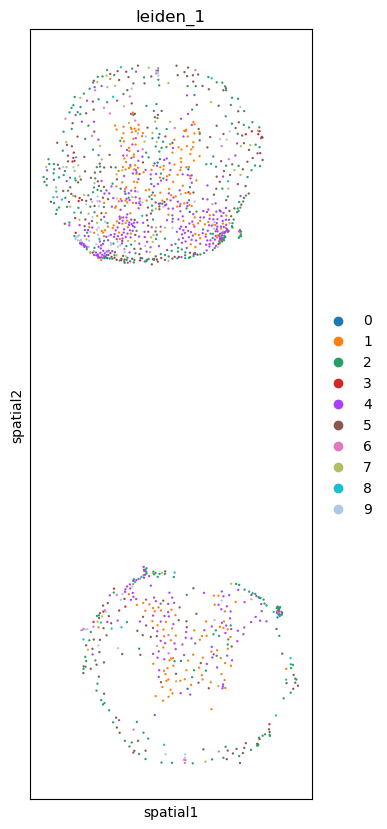

Slide19-DD-1d-2d-myelin-liver__region_2d-myelin-1__baysor_m50_scale4


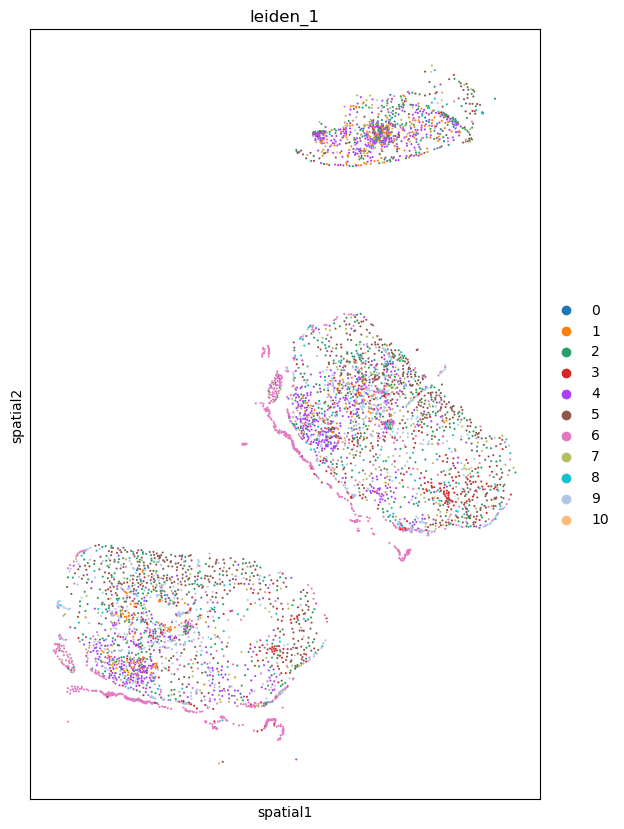

Slide19-DD-1d-2d-myelin-liver__region_2d-myelin-2__baysor_m50_scale4


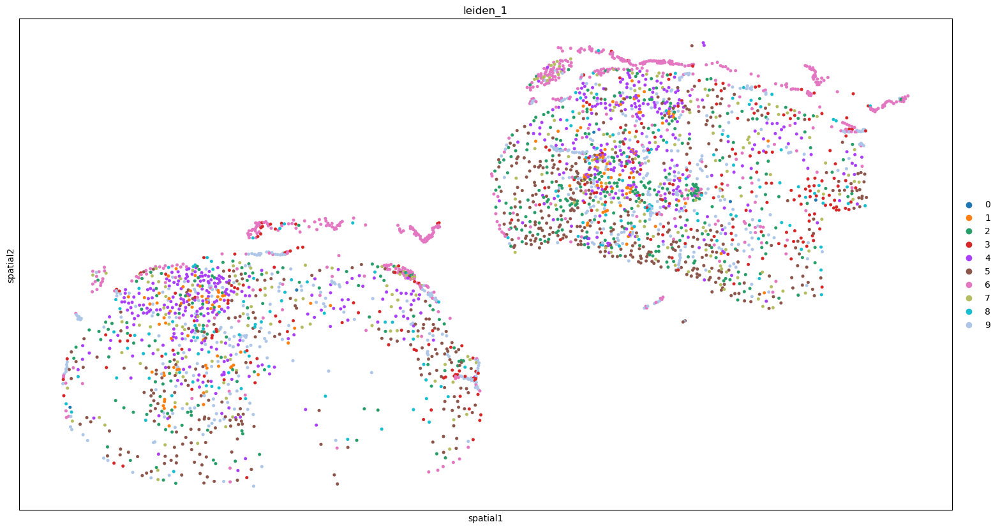

Slide2__region0__m_50_s_4


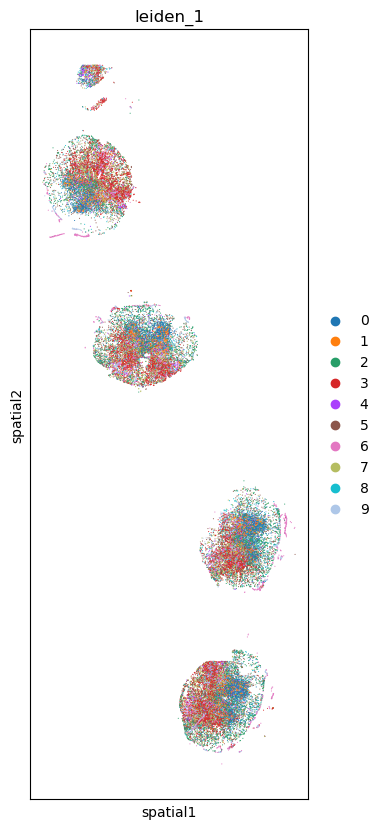

Slide2__region1__m_50_s_4


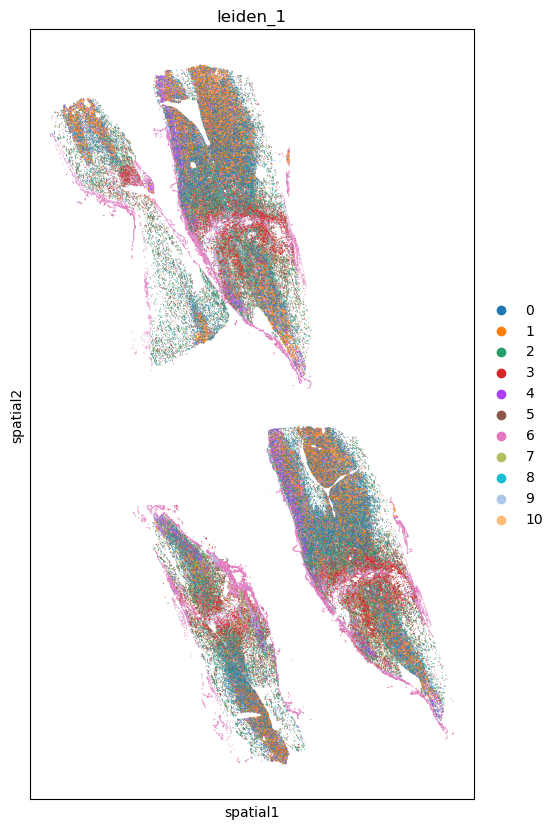

Slide2__region2__m_50_s_4


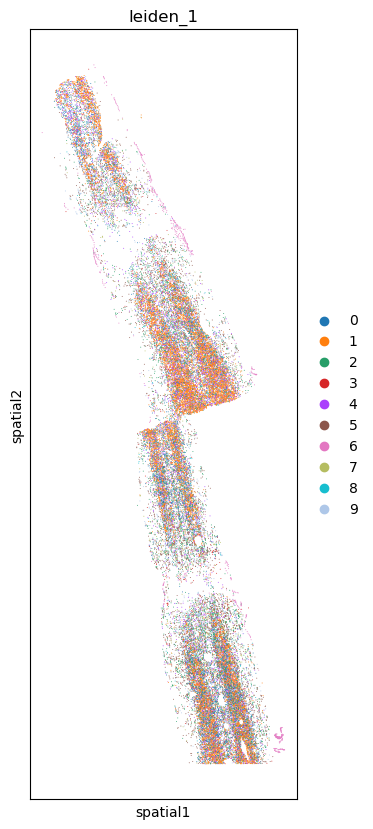

Slide2__region3__m_50_s_4


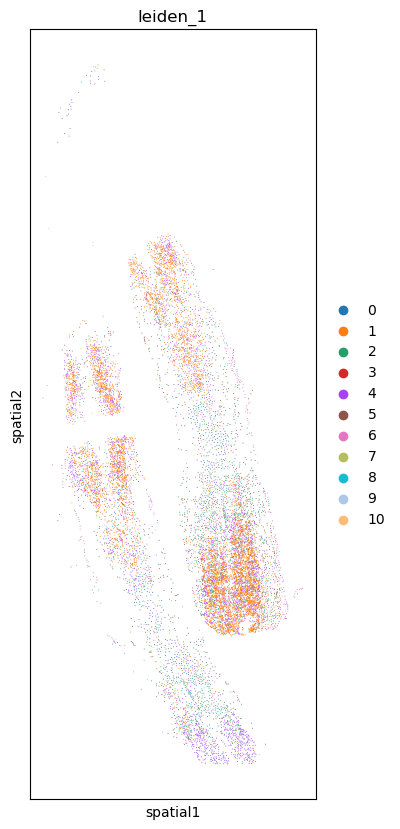

Slide5__region0__m_50_s_4


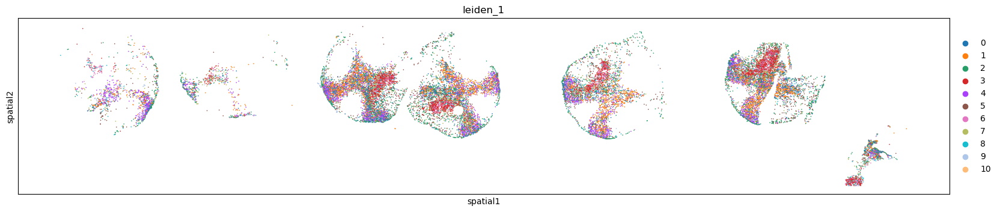

Slide5__region1__m_50_s_4


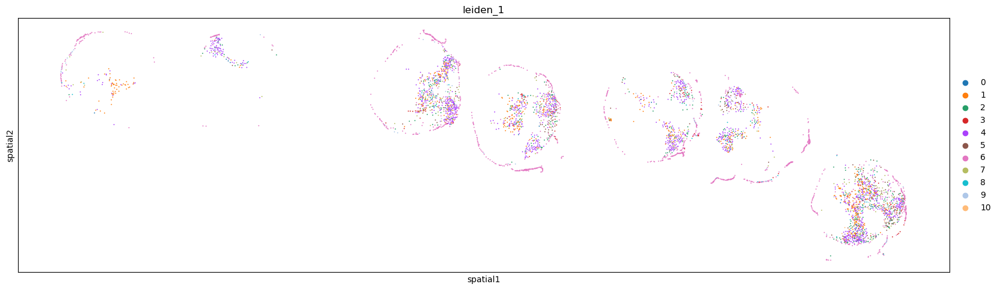

Slide5__region2__m_50_s_4


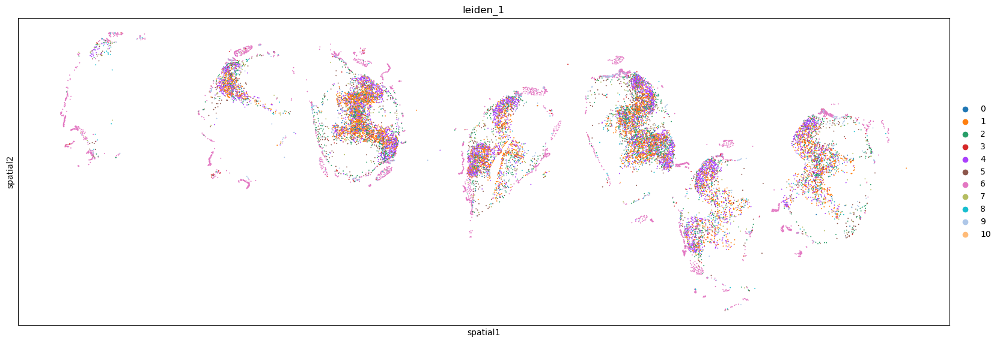

Slide5__region3__m_50_s_4


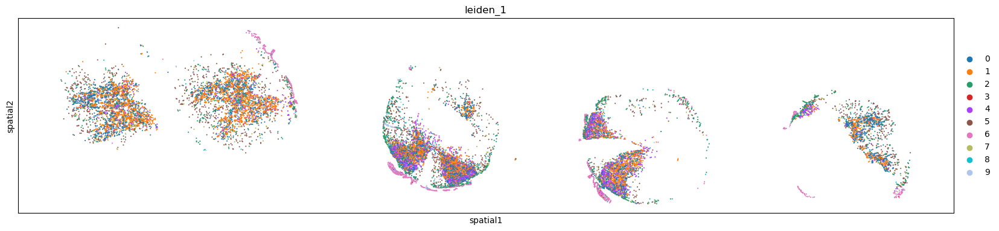

Slide7__region0__m_50_s_4


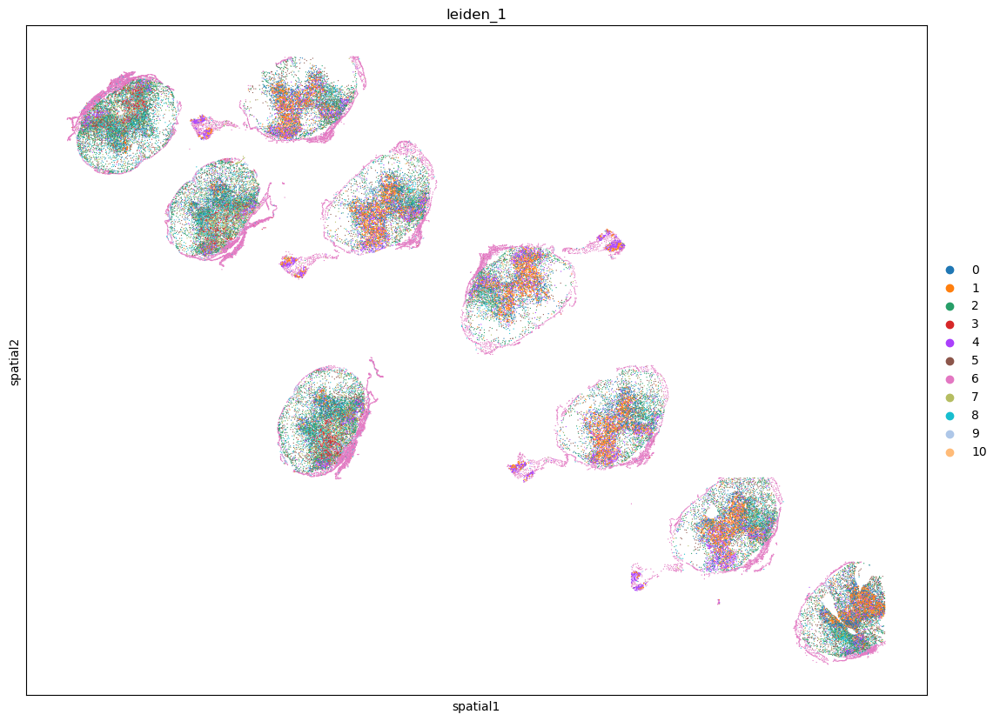

Slide7__region1__m_50_s_4


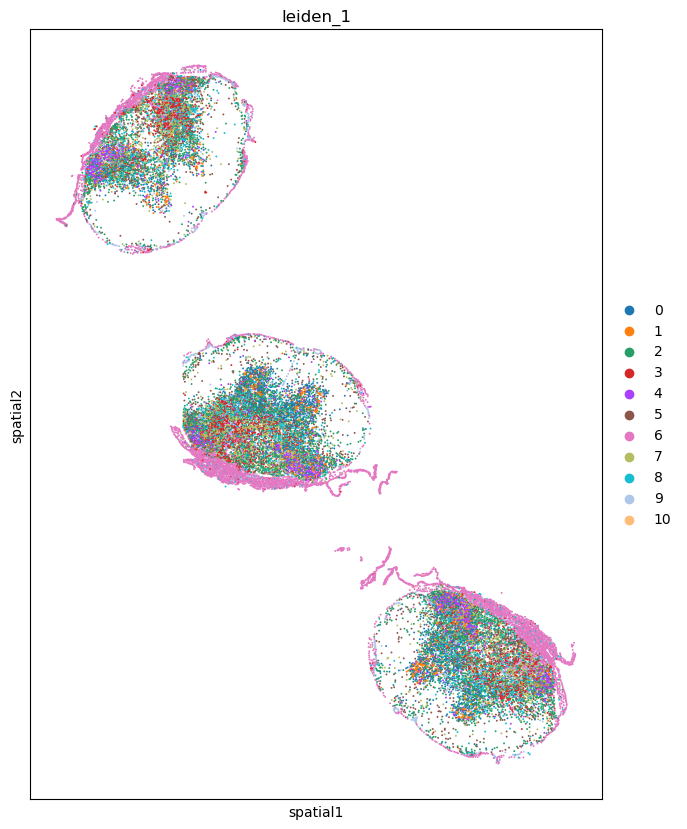

Slide7__region2__m_50_s_4


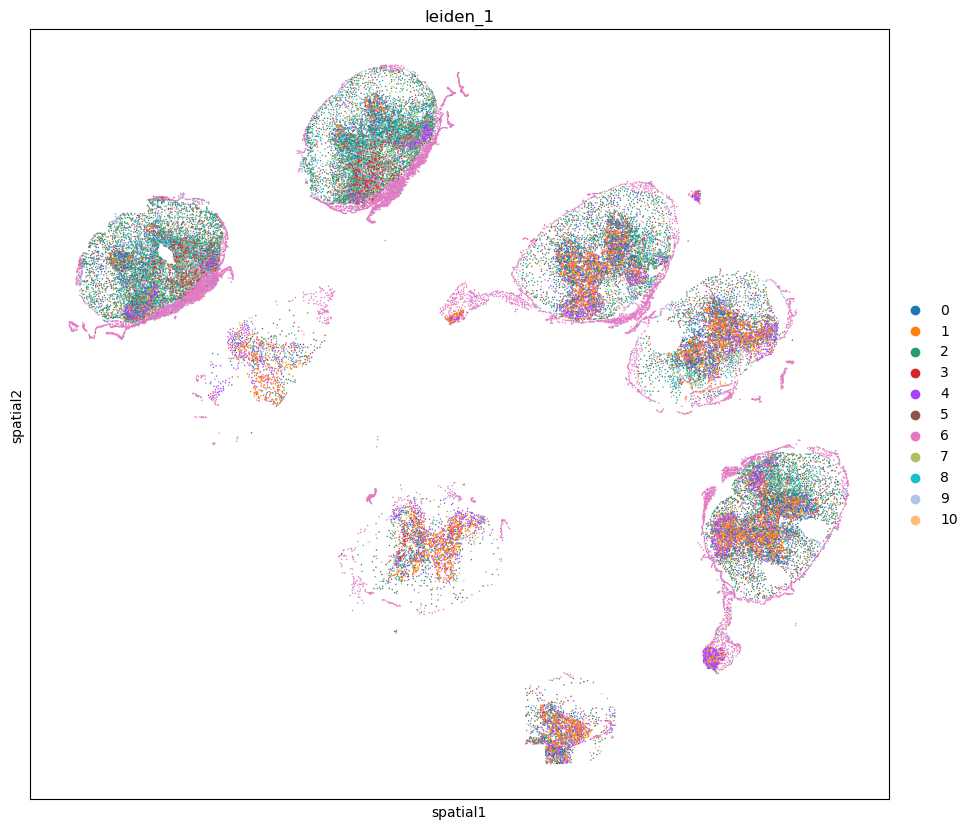

Slide7__region3__m_50_s_4


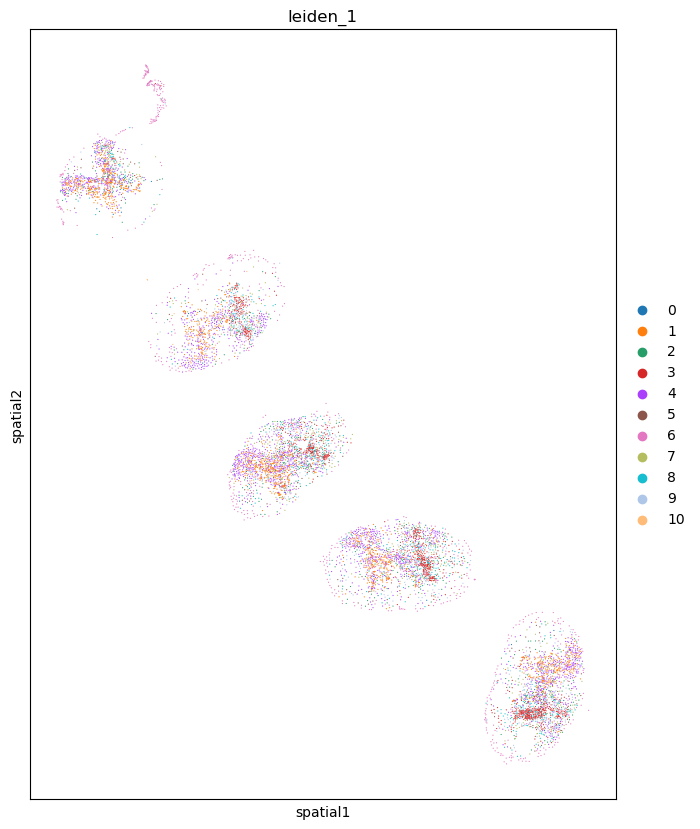

Slide8__region0__m_50_s_4


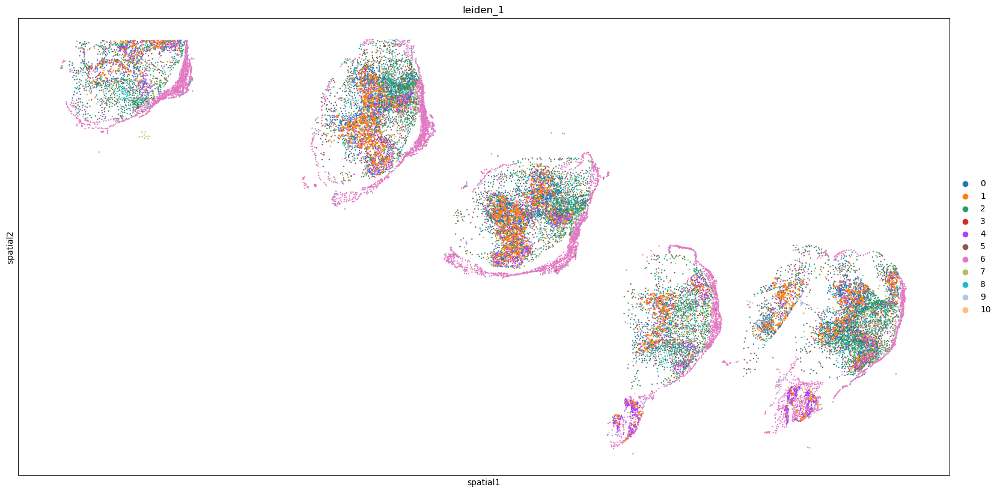

Slide8__region1__m_50_s_4


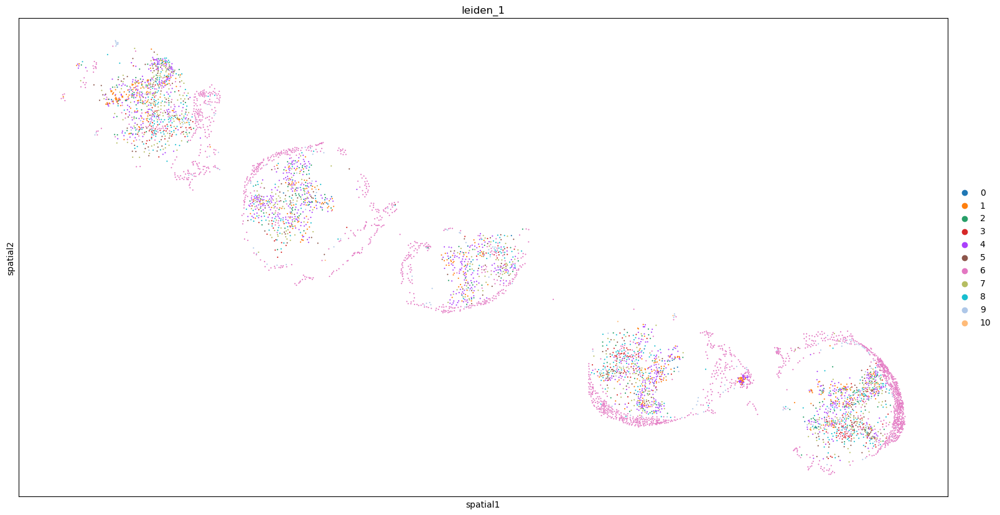

Slide8__region2__m_50_s_4


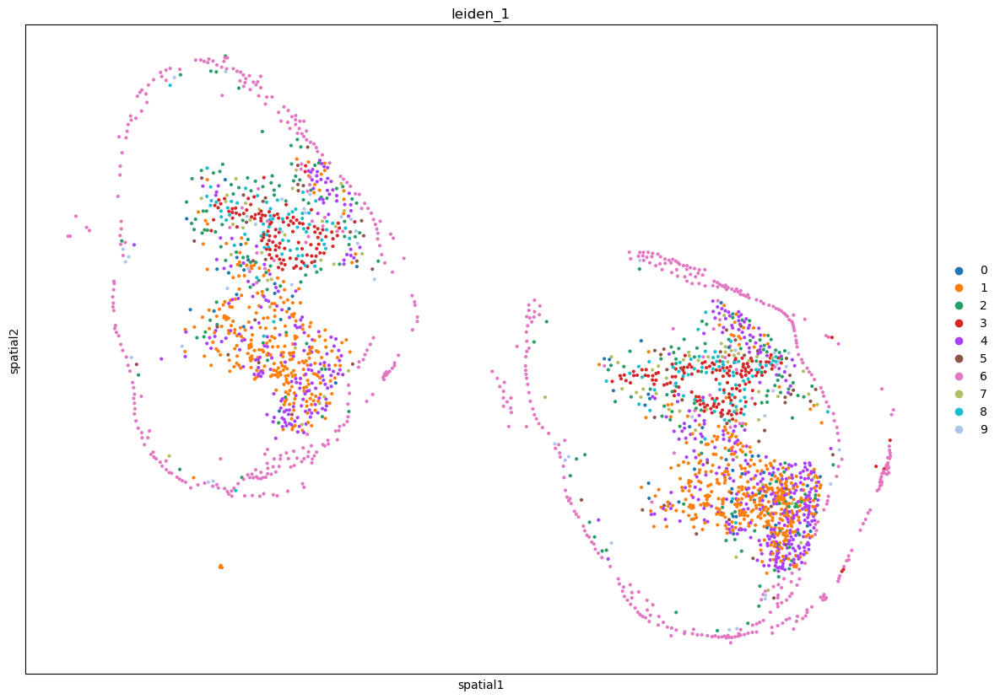

Slide8__region3__m_50_s_4


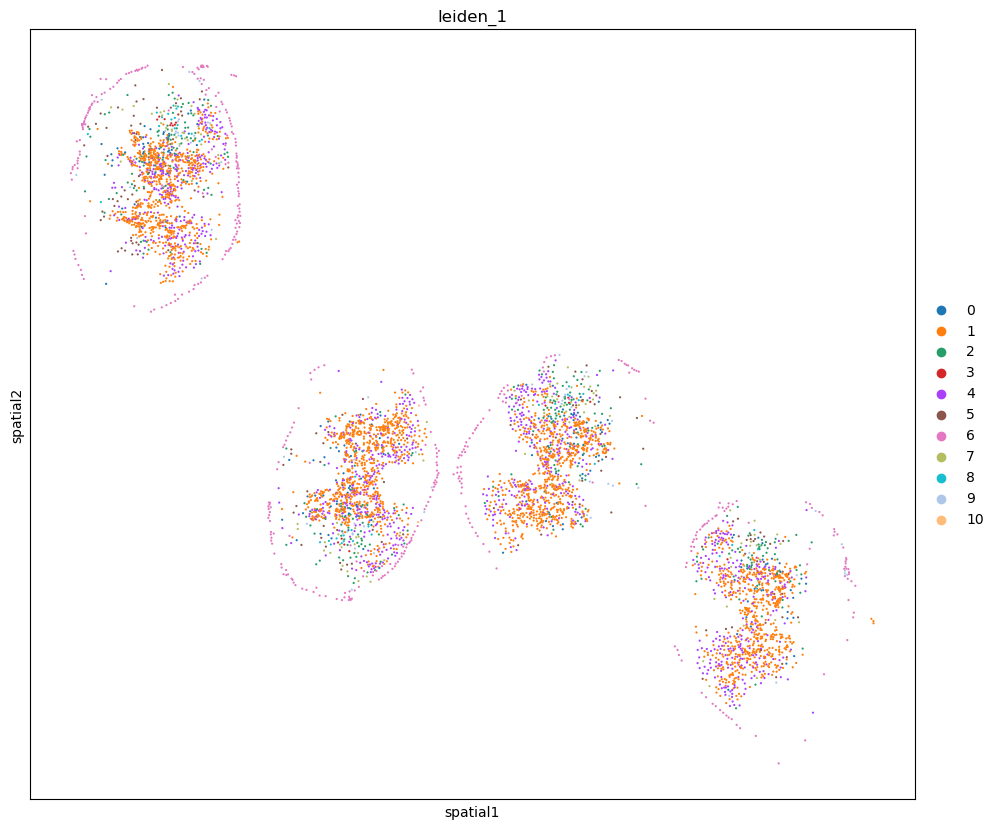

Slide8__region4__m_50_s_4


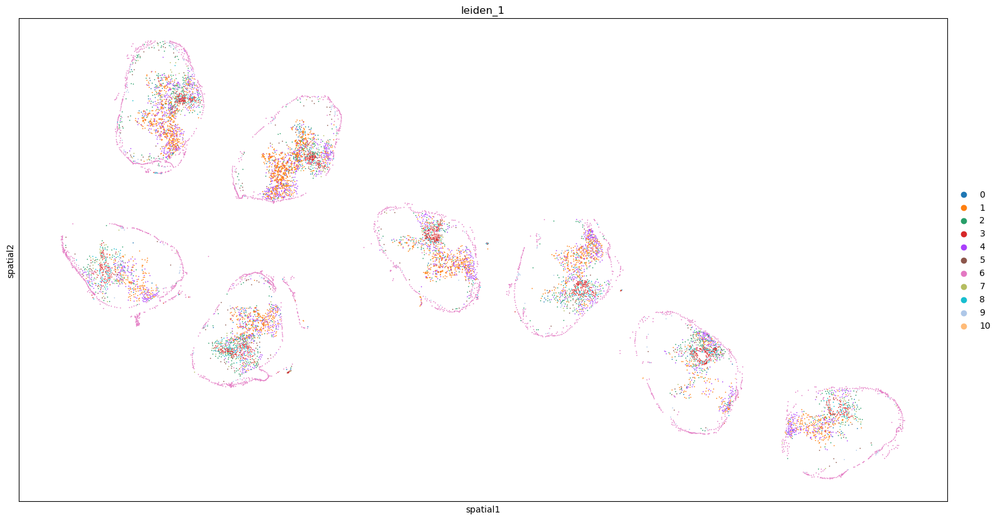

slide18-DD-5d-7d-myelin-liver__region_Myelin-9d-1__baysor_m50_scale4


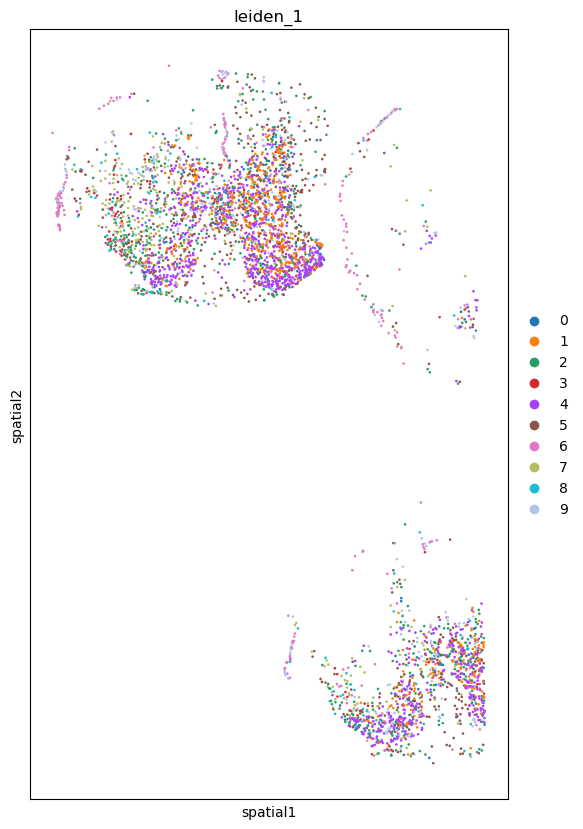

slide18-DD-5d-7d-myelin-liver__region_Myelin-9d-2__baysor_m50_scale4


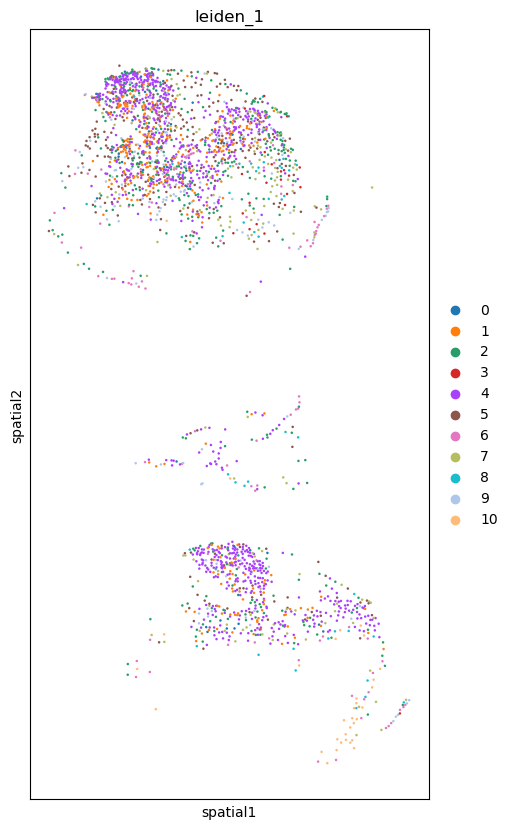

slide18-DD-5d-7d-myelin-liver__region_Myelin-9d-3__baysor_m50_scale4


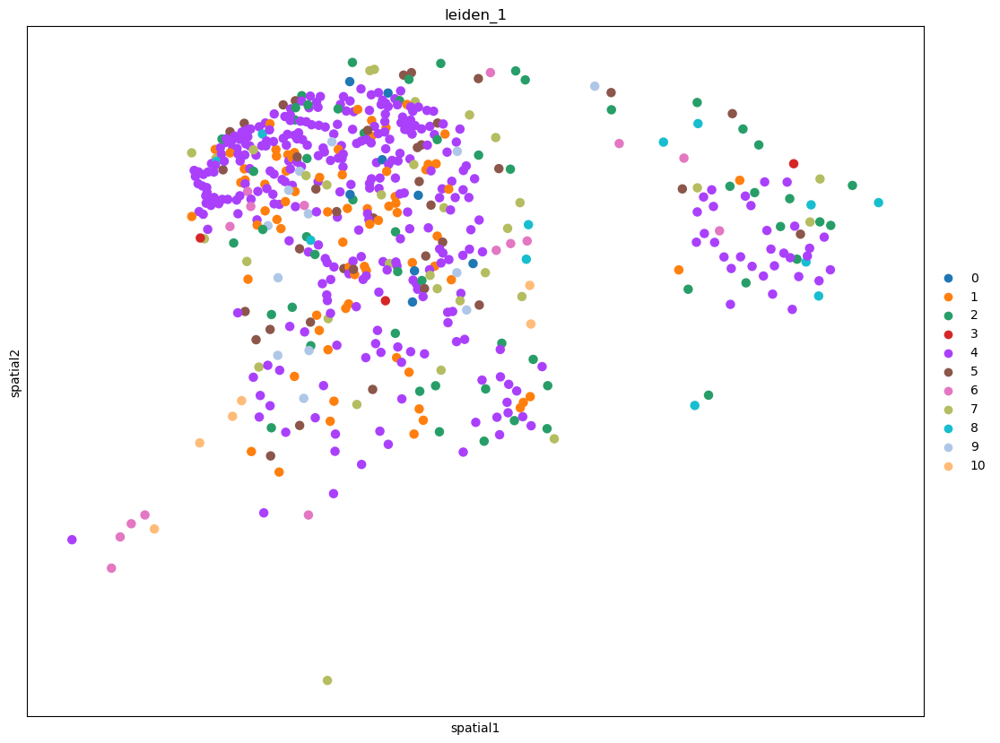

slide18-DD-5d-7d-myelin-liver__region_liver-5d-1__baysor_m50_scale4


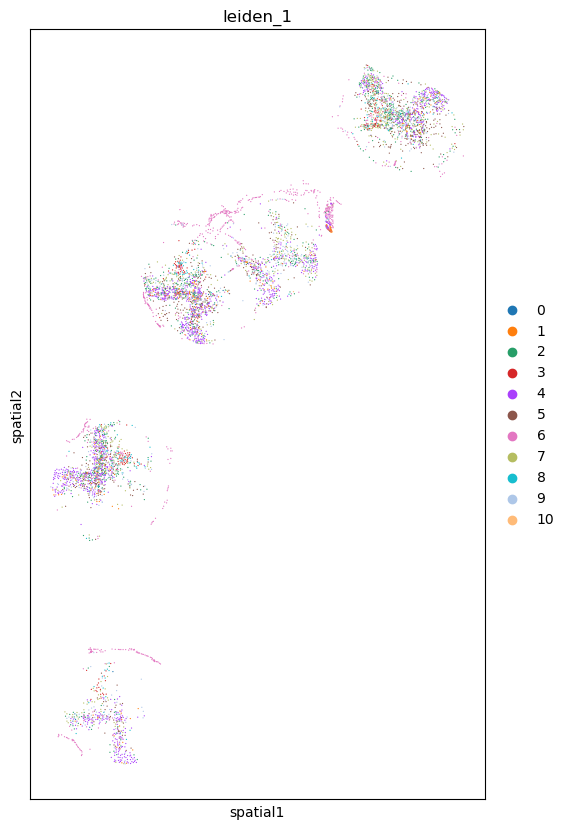

slide18-DD-5d-7d-myelin-liver__region_liver-5d-unc__baysor_m50_scale4


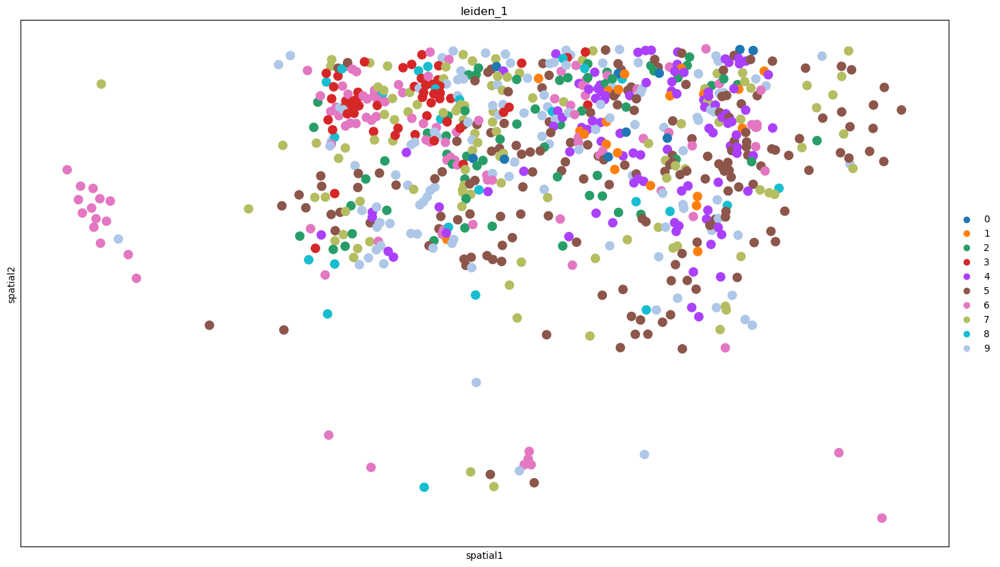

slide18-DD-5d-7d-myelin-liver__region_liver-9d-1__baysor_m50_scale4


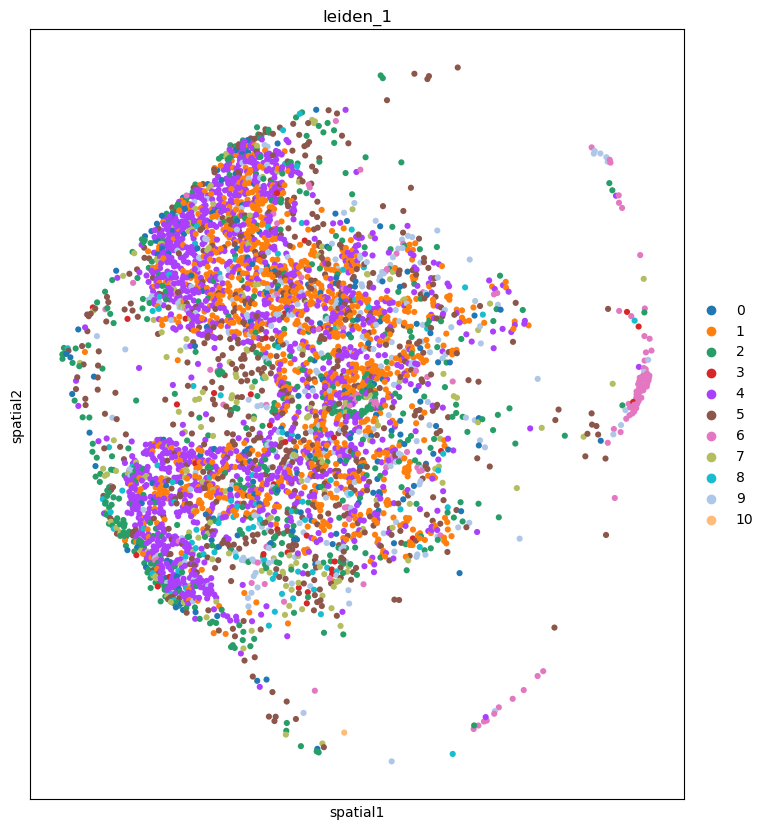

slide18-DD-5d-7d-myelin-liver__region_liver-9d-2__baysor_m50_scale4


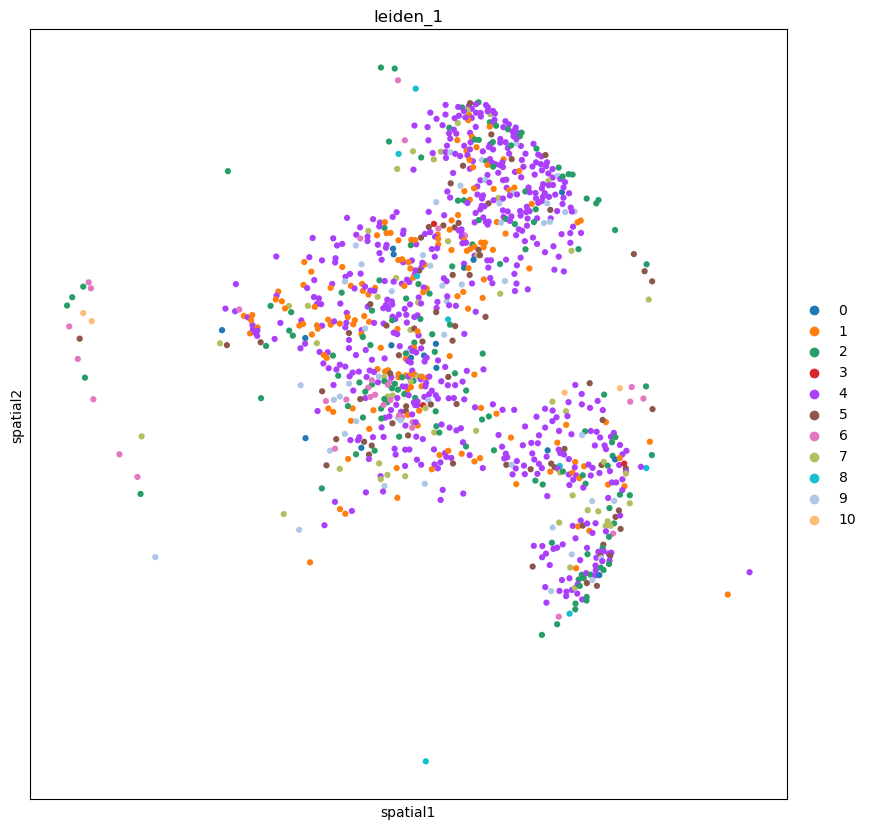

slide18-DD-5d-7d-myelin-liver__region_liver-9d-3__baysor_m50_scale4


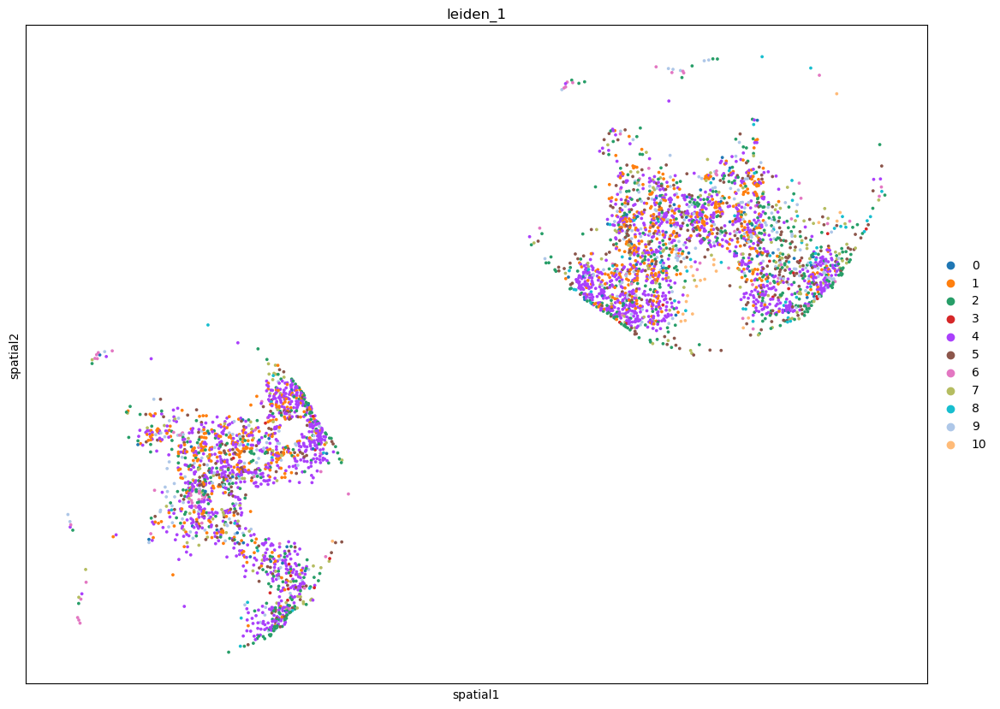

slide18-DD-5d-7d-myelin-liver__region_myelin-5d-1__baysor_m50_scale4


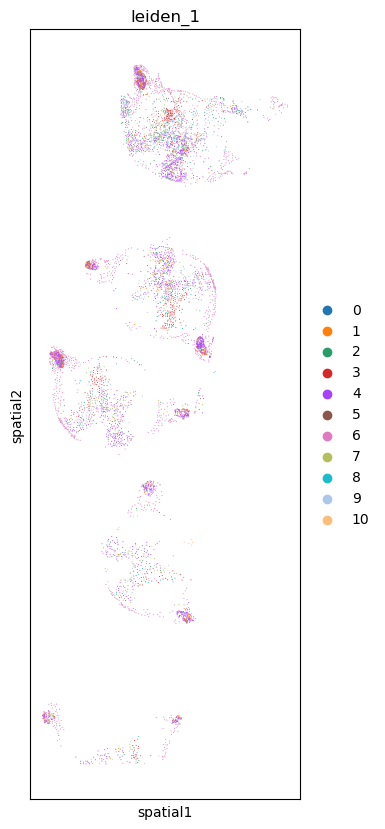

slide20__region_5d-1__baysor_m50_scale4


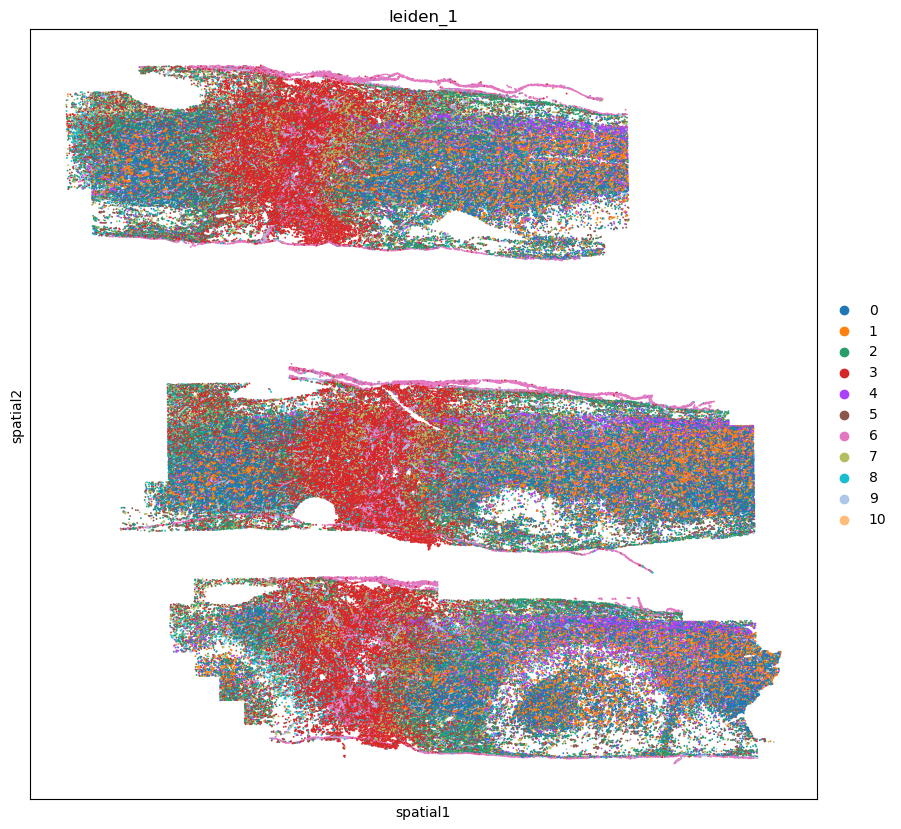

slide20__region_5d-2__baysor_m50_scale4


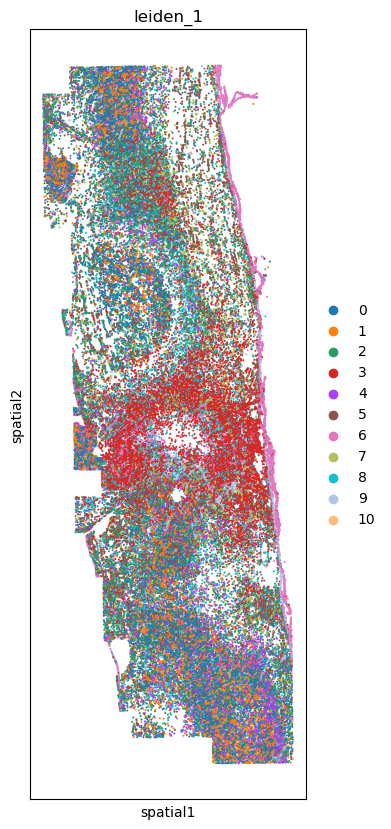

slide20__region_7d-1__m50_s4


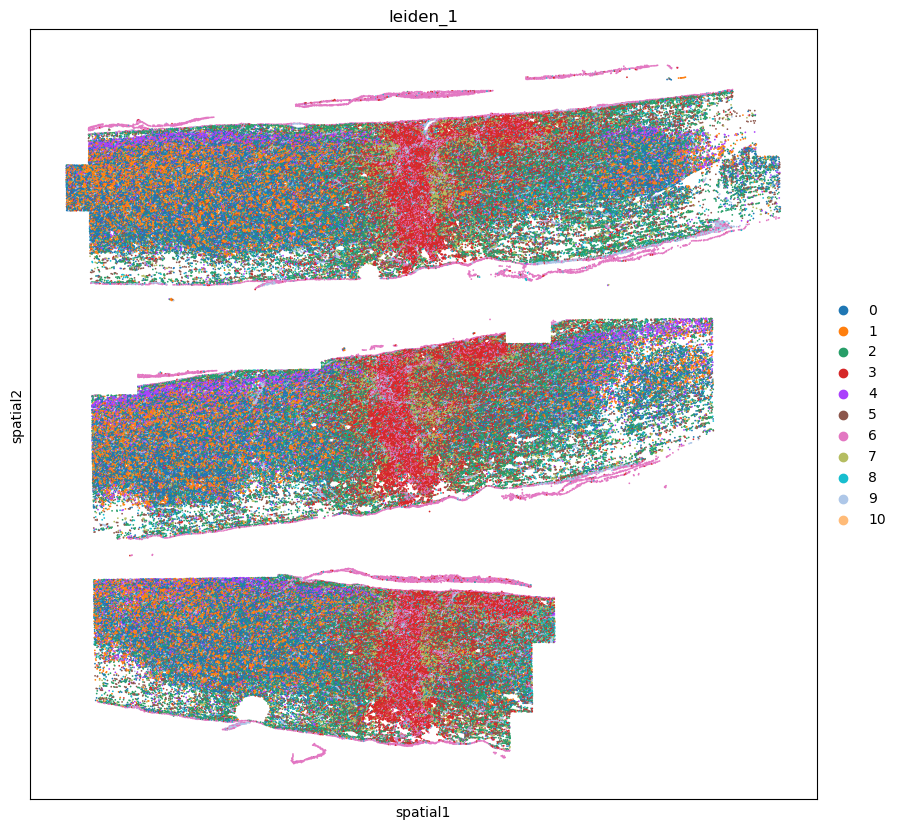

slide20__region_7d-2__m50_s4


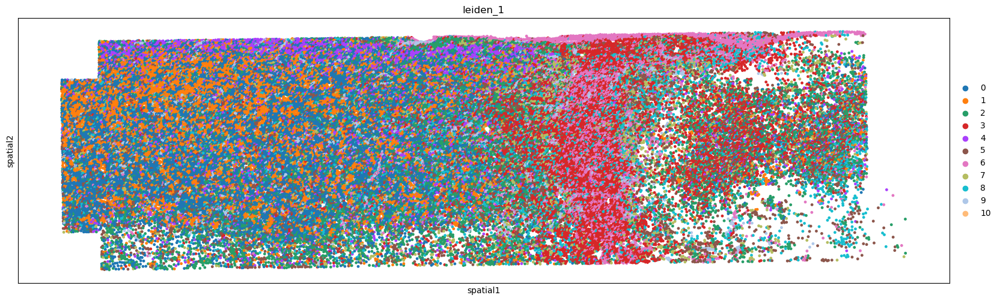

slide20__region_9d-1__m50_s4


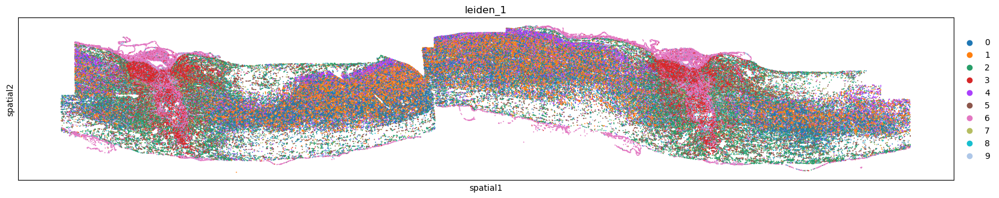

slide20__region_9d-2__m50_s4


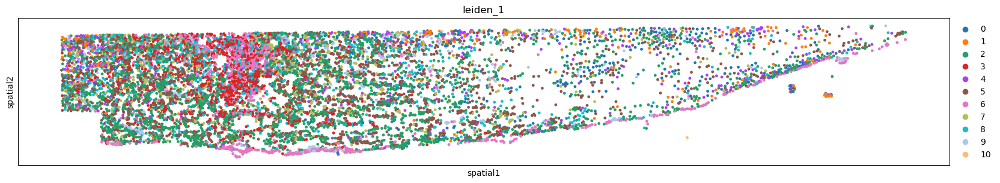

slide20__region_9d-3__m50_s4


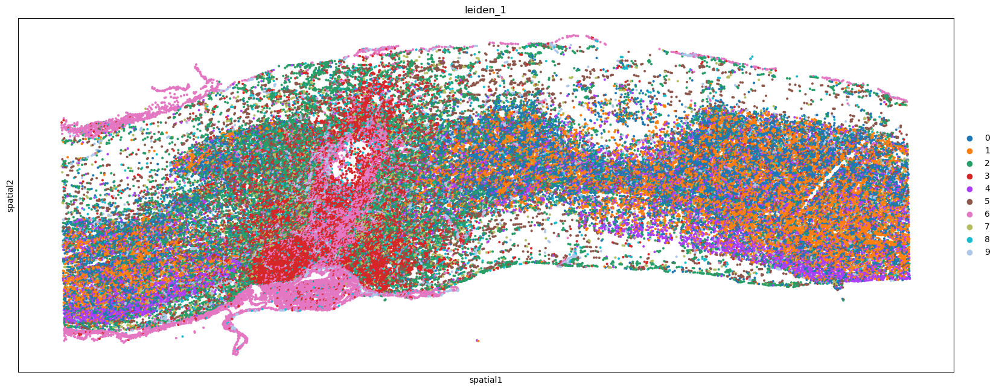

slide21-DD__region_liver-d14-1__m50_s4


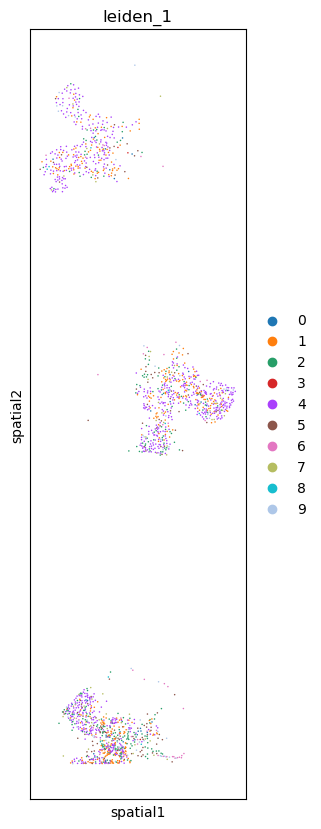

slide21-DD__region_liver-d3-1__m50_s4


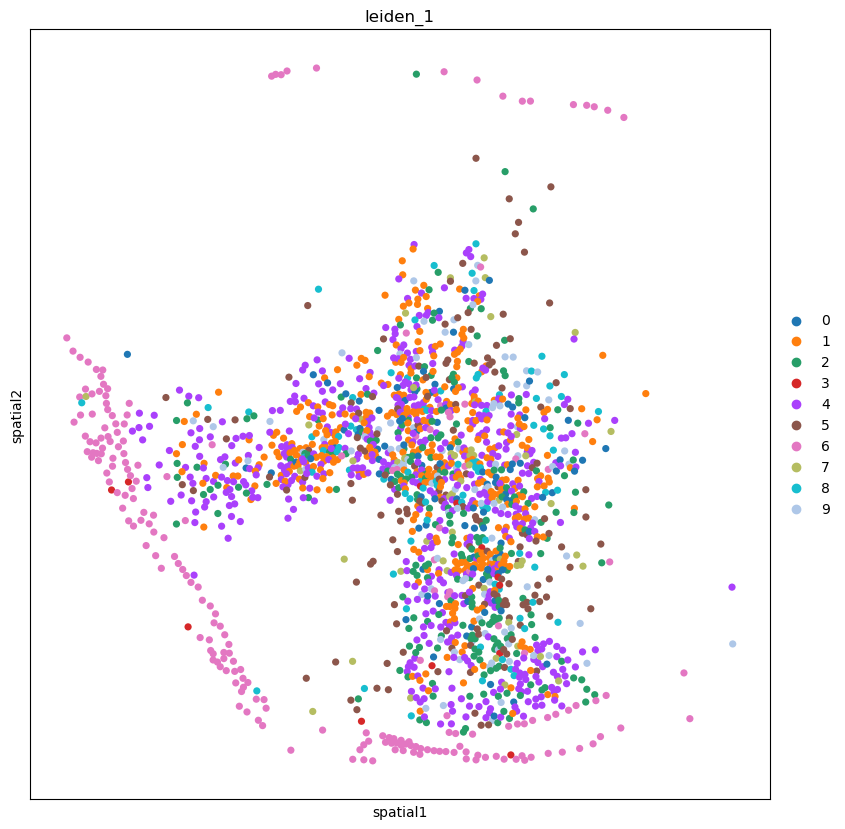

slide21-DD__region_liver-d3-2__m50_s4


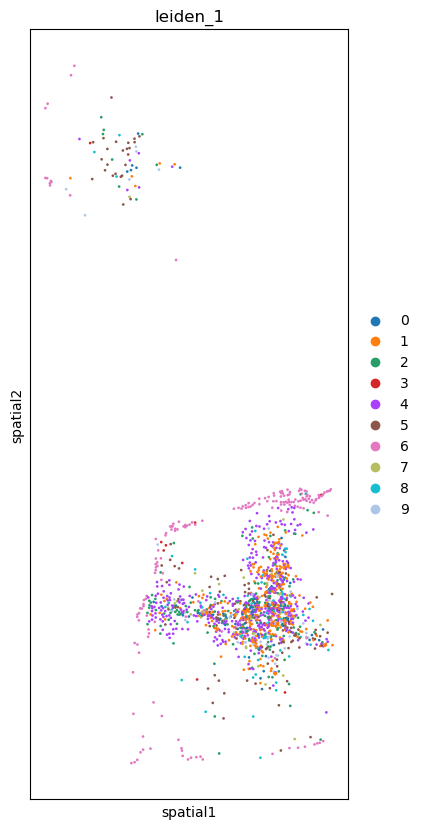

slide21-DD__region_liver-d3-3__m50_s4


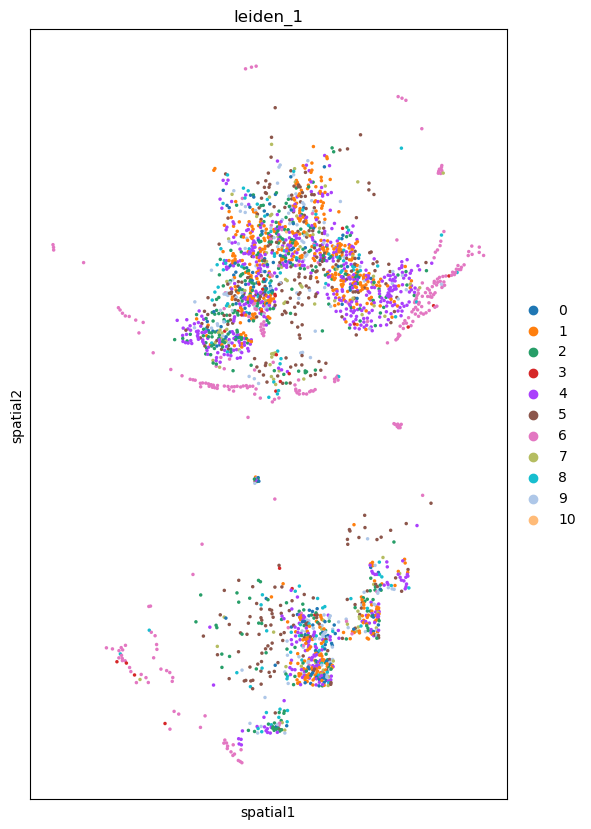

slide21-DD__region_liver-d4-1__m50_s4


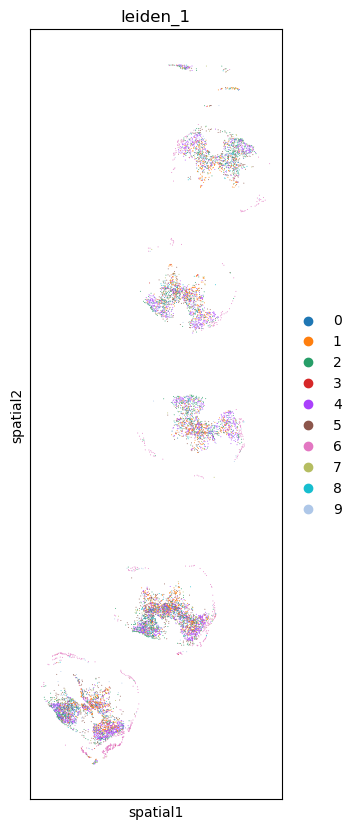

slide21-DD__region_liver-d4-2__m50_s4


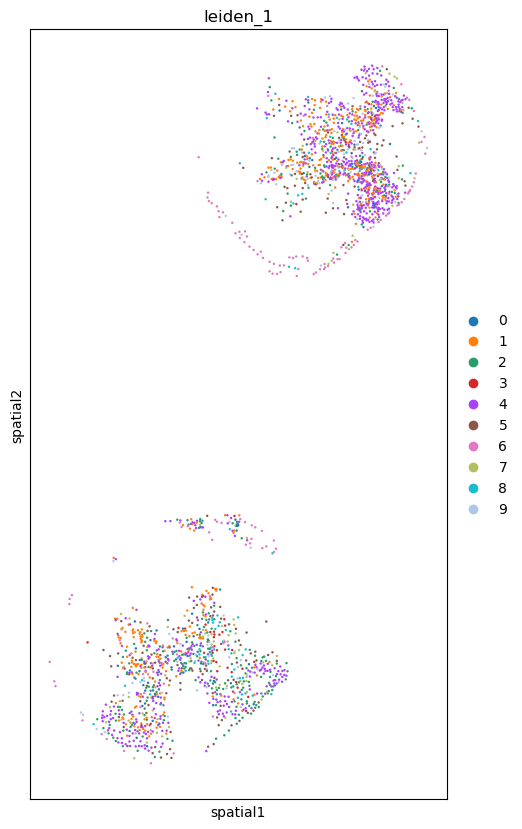

slide21-DD__region_myelin-d14-1__m50_s4


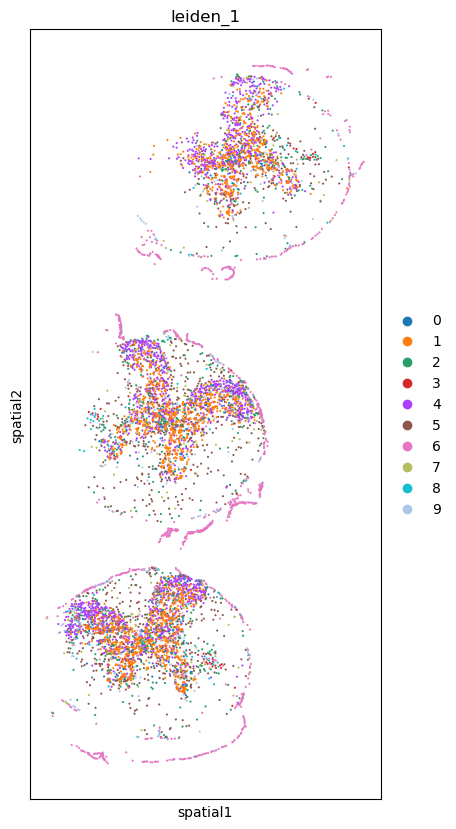

slide21-DD__region_myelin-d14-2__m50_s4


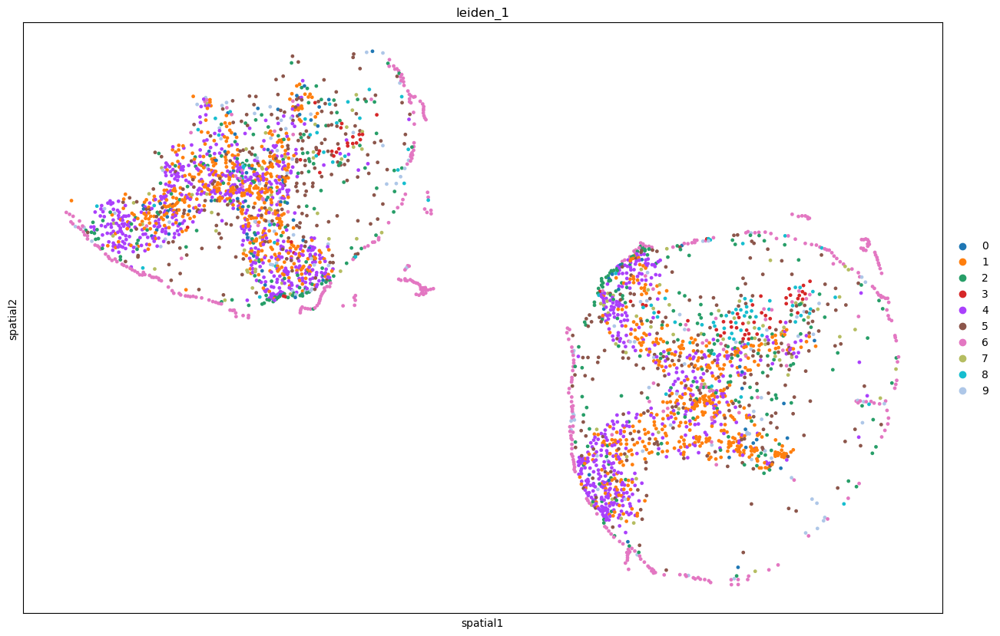

slide21-DD__region_myelin-d14-3__m50_s4


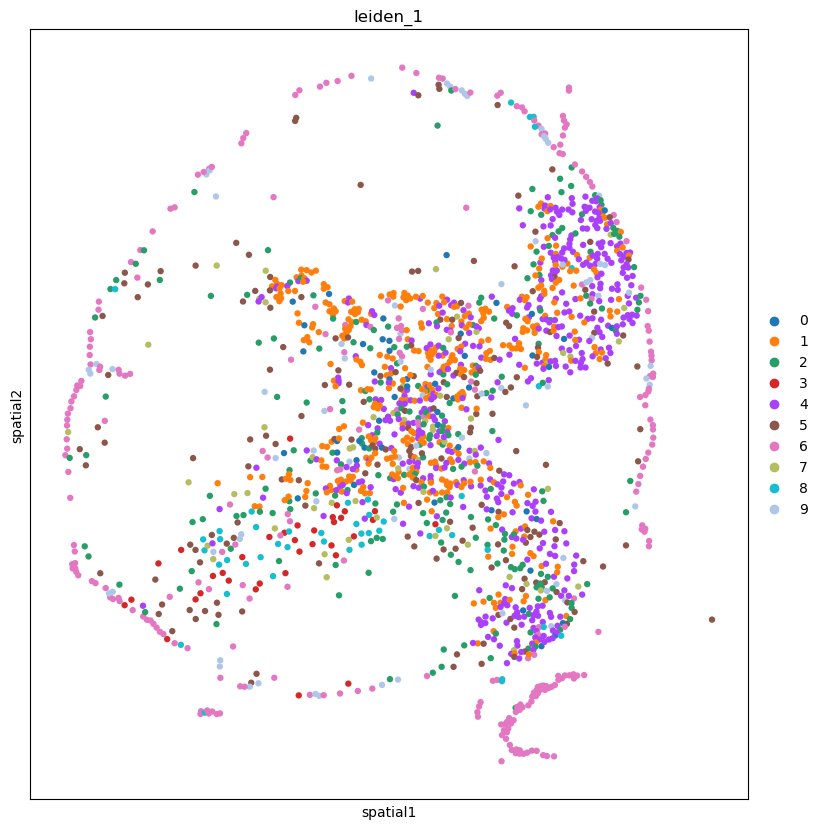

slide21-DD__region_myelin-d14-4__m50_s4


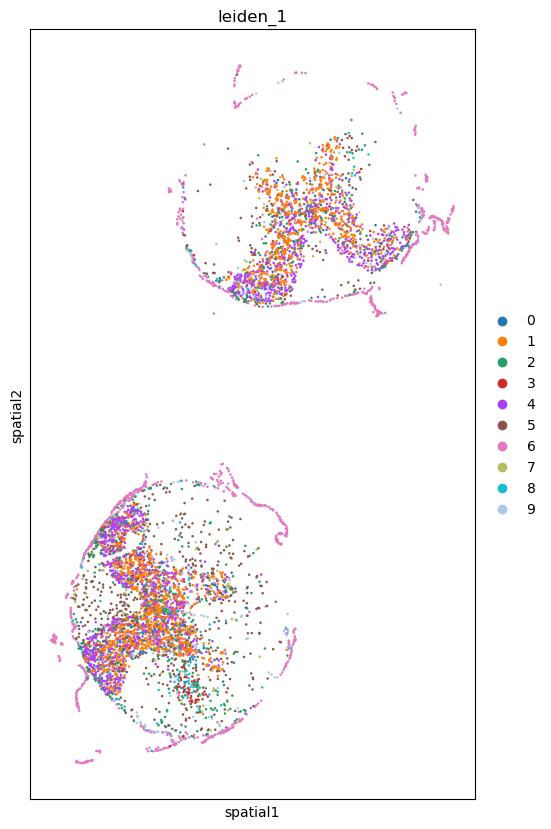

In [29]:
for run in ad.obs['sample_id'].unique():
    print(run)
    ad_int = ad[ad.obs['sample_id'] == run]
    with plt.rc_context({'figure.figsize': (20, 10)}):
        sc.pl.spatial(ad_int, spot_size=15, color = 'leiden_1')
    plt.show()
    